# Datasets

### Estrazione dataset MC

In [3]:
import pandas as pd
import os
from pathlib import Path

def carica_training_dataset():
    """
    Cerca il file Training_datasetMC.csv nelle cartelle tipiche del progetto,
    lo carica, lo pulisce e restituisce un DataFrame con colonne:
    - text
    - label (0/1)
    """

    # 1) Capisco da dove sto eseguendo il notebook
    cwd = Path().resolve()
    print("Current working dir:", cwd)

    # 2) Elenco di possibili percorsi dove potrebbe stare il CSV
    candidate_paths = [
        cwd / "Training_datasetMC.csv",
        cwd / "DataRaw" / "Training_datasetMC.csv",
        cwd.parent / "DataRaw" / "Training_datasetMC.csv",
        cwd.parent / "src" / "DataRaw" / "Training_datasetMC.csv",
    ]

    path_input = None
    for p in candidate_paths:
        if p.exists():
            path_input = p
            break

    if path_input is None:
        raise FileNotFoundError(
            "Non trovo Training_datasetMC.csv. Ho provato questi percorsi:\n" +
            "\n".join(str(p) for p in candidate_paths)
        )

    print("Carico:", path_input)

    # 3) Lettura robusta del CSV (gestisce le virgole dentro le frasi)
    df = pd.read_csv(
        path_input,
        header=None,
        names=["id", "text", "label"],
        quotechar='"',
        sep=",",
        encoding="utf-8",
        engine="python",    # parser più tollerante
        on_bad_lines="skip" # salta eventuali righe rovinate
    )

    print("Shape originale:", df.shape)

    # 4) Rimuovo la colonna ID
    df = df.drop(columns=["id"])

    # 5) Pulizia base del testo
    df["text"] = (
        df["text"]
        .astype(str)
        .str.strip()
        .str.replace(r'^"|"$', "", regex=True)  # rimuove doppi apici ai bordi se presenti
    )

    # 6) Pulizia e conversione della label
    df["label"] = pd.to_numeric(df["label"], errors="coerce")
    df = df.dropna(subset=["label"])
    df["label"] = df["label"].astype(int)

    # 7) Tolgo eventuali righe con testo vuoto
    df = df[df["text"].str.len() > 0]

    # 8) Tolgo eventuali duplicati
    df = df.drop_duplicates(subset=["text", "label"])

    print("Shape pulito:", df.shape)
    return df

train_dfMC = carica_training_dataset()


Current working dir: C:\Users\marco\Desktop\IronyDetection\src\Code
Carico: C:\Users\marco\Desktop\IronyDetection\src\DataRaw\Training_datasetMC.csv
Shape originale: (3996, 3)
Shape pulito: (3995, 2)


In [4]:
# Opzioni estetiche per vedere meglio le frasi
pd.set_option("display.max_colwidth", 200)
pd.set_option("display.max_rows", 40)

train_dfMC = carica_training_dataset()

# Distribuzione ironia / non ironia
print(train_dfMC["label"].value_counts())



Current working dir: C:\Users\marco\Desktop\IronyDetection\src\Code
Carico: C:\Users\marco\Desktop\IronyDetection\src\DataRaw\Training_datasetMC.csv
Shape originale: (3996, 3)
Shape pulito: (3995, 2)
label
0    2006
1    1989
Name: count, dtype: int64


In [5]:

from IPython.display import display, HTML

html_table = train_dfMC.to_html(max_rows=None)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc;">
{html_table}
</div>
"""))


,text,label
0,Che bella giornata per stare chiuso in ufficio tutto il giorno.,1
1,"Finalmente un po' di sole, era ora!",0
2,Mi piace tantissimo quando il treno arriva in ritardo di 40 minuti.,1
3,"Oggi ho fatto una passeggiata, molto rilassante.",0
4,"Wow, un altro compito a sorpresa, che gioia!",1
5,Ho cucinato la pasta ed è venuta davvero buona.,0
6,Non vedo l’ora che inizi la riunione di 3 ore…,1
7,"Stasera esco con gli amici, finalmente!",0
8,"Perfetto, proprio quello che mi serviva: perdere pure l’autobus.",1
9,Ho trovato un bel libro da leggere questo weekend.,0


Abbiamo un numero molto vicino tra le 2 classi
Non avremo problemi di ...

### Pulizia del dataset

Mescolo gli elementi del dataset, per avere omogeneità

In [6]:
# Mescolo completamente le righe del dataset
train_dfMC_shuffled = (
    train_dfMC
    .sample(frac=1, random_state=43)  # frac=1 => prende il 100% delle righe in ordine casuale
    .reset_index(drop=True)           # resetta l'indice dopo lo shuffle
)

train_dfMC = train_dfMC_shuffled

In [7]:
from IPython.display import display, HTML

html_table = train_dfMC_shuffled.to_html(max_rows=None)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc;">
{html_table}
</div>
"""))


,text,label
0,"Ogni volta che parte un corteo radicale, il centro città diventa un percorso a ostacoli.",1
1,"L’acqua è sempre piatta, non curva mai: è la prova più semplice che abbiamo.",0
2,"Perfetto, ora ci manca solo che ti iscrivi alla NASA perché ‘ti senti pronto’.",1
3,Raga ma ogni volta che c’è una notizia sul Medio Oriente sbucano esperti che ieri litigavano per il rigore in Serie A.,1
4,Notevole come il casco scelga sempre di scendere sugli occhi nei momenti meno opportuni.,1
5,"Scommetto che direbbe ‘non fate quelle facce, sembrate usciti da un film drammatico’...",1
6,"La cassa oggi sta andando senza blocchi, già è un miracolo.",0
7,Ho iniziato la serie solo per vedere se davvero è così rivoluzionaria… e per ora la rivoluzione dorme.,1
8,Dire che Napoleone era francese dalla nascita è come confondere la biografia con un poster: era corso e la Francia è arrivata dopo.,1
9,"È importante ascoltare anche le comunità coinvolte, non solo i grandi nomi del tech.",0


**Non verrà rimossa la punteggiatura**  
Il modello transformer tratta come token unici anche gli elementi di punteggiatura, utili per capire l'ironia.

**Però rimuoveremo le EMOJI**  = Sono poche, quindi non porterebbero informazione al nostro modello

**Trasformeremo tutto in minuscolo**  = E' standard per questo tipo di modelli testuali

**Uniformare gli apostrofi**  =  ' unico tipo apostrofo, più facile da tokenizzare

**Rimuovere spazi multipli** = usati per la tokenizzazione



In [8]:
import re


# Regex UNIVERSALE che prende (quasi) tutte le emoji moderne:
emoji_pattern = re.compile(
    "["
    "\U0001F000-\U0001FFFF"  # tutto il blocco multilingue (contiene TUTTE le emoji moderne)
    "\u2600-\u26FF"          # simboli vari (☀️, ☂️ ecc.)
    "\u2700-\u27BF"          # dingbats (✂️, ✌️ ecc.)
    "]+",
    flags=re.UNICODE
)


def pulisci_testo(t):
    t = str(t)

    # 1. rimozione emoji
    t = emoji_pattern.sub(r'', t)

    # 2. minuscolo
    t = t.lower()

    # 3. normalizzazione apostrofi
    t = t.replace("’", "'").replace("‘", "'")

    # 4. rimuove spazi multipli
    t = re.sub(r"\s+", " ", t)

    # 5. rimuove spazi ai bordi
    t = t.strip()

    return t

train_dfMC["text"] = train_dfMC["text"].apply(pulisci_testo)


In [9]:
from IPython.display import display, HTML

html_table = train_dfMC.to_html(max_rows=None)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc;">
{html_table}
</div>
"""))

,text,label
0,"ogni volta che parte un corteo radicale, il centro città diventa un percorso a ostacoli.",1
1,"l'acqua è sempre piatta, non curva mai: è la prova più semplice che abbiamo.",0
2,"perfetto, ora ci manca solo che ti iscrivi alla nasa perché 'ti senti pronto'.",1
3,raga ma ogni volta che c'è una notizia sul medio oriente sbucano esperti che ieri litigavano per il rigore in serie a.,1
4,notevole come il casco scelga sempre di scendere sugli occhi nei momenti meno opportuni.,1
5,"scommetto che direbbe 'non fate quelle facce, sembrate usciti da un film drammatico'...",1
6,"la cassa oggi sta andando senza blocchi, già è un miracolo.",0
7,ho iniziato la serie solo per vedere se davvero è così rivoluzionaria… e per ora la rivoluzione dorme.,1
8,dire che napoleone era francese dalla nascita è come confondere la biografia con un poster: era corso e la francia è arrivata dopo.,1
9,"è importante ascoltare anche le comunità coinvolte, non solo i grandi nomi del tech.",0


### Creazione del testset

In [10]:
import pandas as pd
from pathlib import Path
import re
from IPython.display import display, HTML

# ==========================
#  Regex emoji universale
# ==========================
emoji_pattern = re.compile(
    "["
    "\U0001F000-\U0001FFFF"   # quasi tutte le emoji moderne
    "\u2600-\u26FF"           # simboli vari
    "\u2700-\u27BF"           # dingbats
    "]+",
    flags=re.UNICODE
)

# ==========================
#  Pulizia testo MC
# ==========================
def pulisci_testo_mc(t: str) -> str:
    t = str(t)

    # 1) Rimuove emoji
    t = emoji_pattern.sub("", t)

    # 2) Minuscolo
    t = t.lower()

    # 3) Normalizza apostrofi
    t = t.replace("’", "'").replace("‘", "'")

    # 4) Spazi multipli -> uno solo
    t = re.sub(r"\s+", " ", t)

    # 5) Strip finale
    t = t.strip()

    return t

# ==========================
#  Carica TEST MC
# ==========================
def carica_test_dataset_mc():
    """
    Cerca il file Test_datasetMC.csv nelle cartelle tipiche del progetto,
    lo carica, lo pulisce da righe sporche e restituisce un DataFrame con:
      - text
      - label (0/1)
    """

    cwd = Path().resolve()
    print("Current working dir:", cwd)

    filename = "Test_datasetMC.csv"

    candidate_paths = [
        cwd / filename,
        cwd / "DataRaw" / filename,
        cwd.parent / "DataRaw" / filename,
        cwd.parent / "src" / "DataRaw" / filename,
    ]

    path_input = None
    for p in candidate_paths:
        if p.exists():
            path_input = p
            break

    if path_input is None:
        raise FileNotFoundError(
            "Non trovo Test_datasetMC.csv. Ho provato questi percorsi:\n" +
            "\n".join(str(p) for p in candidate_paths)
        )

    print("Carico TEST MC da:", path_input)

    # Lettura robusta del CSV (gestisce virgole dentro le frasi)
    df = pd.read_csv(
        path_input,
        header=None,
        names=["id", "text", "label"],
        quotechar='"',
        sep=",",
        encoding="utf-8",
        engine="python",
        on_bad_lines="skip"
    )

    print("Shape originale test:", df.shape)

    # Rimuovo colonna id
    df = df.drop(columns=["id"])

    # Pulizia base del testo
    df["text"] = (
        df["text"]
        .astype(str)
        .str.strip()
        .str.replace(r'^"|"$', "", regex=True)  # toglie doppi apici ai bordi se presenti
    )

    # Pulizia/convert label
    df["label"] = pd.to_numeric(df["label"], errors="coerce")
    df = df.dropna(subset=["label"])
    df["label"] = df["label"].astype(int)

    # Tolgo righe con testo vuoto
    df = df[df["text"].str.len() > 0]

    # Tolgo duplicati testo+label
    df = df.drop_duplicates(subset=["text", "label"])

    print("Shape pulito test:", df.shape)
    print("Distribuzione label (test):")
    print(df["label"].value_counts())

    return df

# ==========================
#  Carico, mescolo, pulisco, visualizzo
# ==========================

test_dfMC = carica_test_dataset_mc()

# Mescolo le righe del test
test_dfMC = test_dfMC.sample(frac=1, random_state=43).reset_index(drop=True)

# Applico pulizia testo
test_dfMC["text"] = test_dfMC["text"].apply(pulisci_testo_mc)

# Visualizzazione scrollabile
html_table_test = test_dfMC.to_html(max_rows=None)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc;">
{html_table_test}
</div>
"""))


Current working dir: C:\Users\marco\Desktop\IronyDetection\src\Code
Carico TEST MC da: C:\Users\marco\Desktop\IronyDetection\src\DataRaw\Test_datasetMC.csv
Shape originale test: (938, 3)
Shape pulito test: (938, 2)
Distribuzione label (test):
label
1    469
0    469
Name: count, dtype: int64


,text,label
0,mi rende felice quando ti giri e sorridi anche se sei tutto bagnato.,0
1,non mi piace che ti chiudi completamente ogni volta che c'è un problema vero.,0
2,"a volte mi pesa davvero l'umore instabile, mi sento meno me stessa.",0
3,"l'importante è che tu ti senta a tuo agio, non devi seguire per forza la moda.",0
4,mi piace tenere gli attrezzi in ordine per lavorare più veloce e pulito.,0
5,"beh certo, poteva andare peggio: almeno non è arrivata anche la folla a filmare.",1
6,"non mi piace quando ignori i problemi, se un posto non è pulito lo dico e basta.",0
7,"non mi piace dover uscire quando sto così, preferirei restare tranquilla a casa.",0
8,mi piace ridere con gli amici mentre ci passiamo vicino per non perderci tra la gente.,0
9,"se ci fosse una medaglia per l'arte del rovinare un'occasione, l'avresti già vinta.",1


### Estrazione dataset IronITA

Estraiamo il training set di IronITA, rimuoviamo le colonne che non ci interessano e unifichiamo **Irony** e **Sarcasm**,
- se c'è 1 in almeno uno dei due, allora => 1
- se non c'è allora => 0

In [11]:
import pandas as pd
from pathlib import Path

def carica_training_ironita():
    """
    Carica il file training_ironita2018.xlsx, elimina id e topic,
    unisce irony e sarcasm in un'unica label binaria (0/1) e
    restituisce un DataFrame con colonne:
      - text
      - label (1 se ironia o sarcasmo, 0 altrimenti)
    """

    cwd = Path().resolve()
    print("Current working dir:", cwd)

    filename = "training_ironita2018.xlsx"

    # Possibili percorsi (come per MC)
    candidate_paths = [
        cwd / filename,
        cwd / "DataRaw" / filename,
        cwd.parent / "DataRaw" / filename,
        cwd.parent / "src" / "DataRaw" / filename,
    ]

    path_input = None
    for p in candidate_paths:
        if p.exists():
            path_input = p
            break

    if path_input is None:
        raise FileNotFoundError(
            f"Non trovo {filename}. Ho provato questi percorsi:\n" +
            "\n".join(str(p) for p in candidate_paths)
        )

    print("Carico:", path_input)

    # Leggo l'Excel (header sulla prima riga)
    df = pd.read_excel(path_input)

    print("Colonne trovate:", list(df.columns))
    print("Shape originale:", df.shape)

    # Normalizzo i nomi delle colonne (minuscolo, niente spazi)
    df.columns = [c.strip().lower() for c in df.columns]

    # Mi aspetto queste colonne: id, text, irony, sarcasm, topic
    # In caso di nomi leggermente diversi puoi sistemarli qui.
    text_col = "text"
    irony_col = "irony"
    sarcasm_col = "sarcasm"

    # Riempio eventuali NaN con 0 nelle colonne irony/sarcasm
    df[irony_col] = df[irony_col].fillna(0)
    df[sarcasm_col] = df[sarcasm_col].fillna(0)

    # Converto a intero (0/1)
    df[irony_col] = df[irony_col].astype(int)
    df[sarcasm_col] = df[sarcasm_col].astype(int)

    # Nuova label: 1 se almeno uno dei due è 1, altrimenti 0
    df["label"] = ((df[irony_col] == 1) | (df[sarcasm_col] == 1)).astype(int)

    # Costruisco il DataFrame finale: SOLO text + label
    df_out = df[[text_col, "label"]].copy()

    # Tolgo eventuali righe vuote / NaN nel testo
    df_out = df_out.dropna(subset=["text"])
    df_out["text"] = df_out["text"].astype(str).str.strip()
    df_out = df_out[df_out["text"].str.len() > 0]

    # Tolgo duplicati testo+label (facoltativo ma pulito)
    df_out = df_out.drop_duplicates(subset=["text", "label"])

    print("Shape pulito IronITA train:", df_out.shape)
    print("Distribuzione label:")
    print(df_out["label"].value_counts())

    return df_out


In [12]:
train_dfITA = carica_training_ironita()
from IPython.display import display, HTML

html_table = train_dfITA.to_html(max_rows=None)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc;">
{html_table}
</div>
"""))


Current working dir: C:\Users\marco\Desktop\IronyDetection\src\Code
Carico: C:\Users\marco\Desktop\IronyDetection\src\DataRaw\training_ironita2018.xlsx
Colonne trovate: ['id', 'text', 'irony', 'sarcasm', 'topic']
Shape originale: (3977, 5)
Shape pulito IronITA train: (3976, 2)
Distribuzione label:
label
1    2022
0    1954
Name: count, dtype: int64


,text,label
0,"Zurigo, trovato morto il presunto autore della sparatoria nel centro islamico #20dicembre https://t.co/rBjvUi8RJ2",0
1,"Zurigo, trovato morto il presunto autore della sparatoria nel centro islamico - https://t.co/XMrEqPnV6w tramite https://t.co/zAAl3RtO5F",0
2,"Zingari..i soliti ""MERDOSI""..#cacciamolivia Roma, i rom aggrediscono un 81enne per rapinarlo. Bloccati dai cittadini https://t.co/j6LYylIkhe",0
3,"Zingari di merda,tutti al muro...bastardi Sparano ai carabinieri dopo la rapina: presi nel campo nomadi di Giugliano https://t.co/efYYDutXvs",0
4,zero notizie decreto #tfaordinario II ciclo zero notizie prove scritte. Alla faccia de #labuonascuola.#matteorenzi cosa stai aspettando?,1
5,"Yemen, primo raid ordinato da Trump: uccisi 14 terroristi, ma c’è anche un morto fra i soldati Usa … https://t.co/A8ssHTbUt5",0
6,"Yao,i 3 rom si accusano a vicenda:Delusi dal bottino https://t.co/bLibkhlnX5 @FabrizioSantori NO PROBLEM IN GALERA TUTTI E 3 FINE PENA MAI!!",0
7,YAHOO!!Scoperti 7 nuovi pianeti simili alla terra!!forse abbiamo trovato la soluzione per il ricollocamento dei migranti!!,1
8,x: non si entra nell'angolo rotture della Lidl rom: AAAAAAAAAAAAAAAAAAAAAH https://t.co/lQczymCw8x,1
9,"x il ministro Giannini questo è l'anno della buona scuola,che è cambiato?ci ha messo lo zucchero?nn si possono più sentire tante str...",1


### Pulizia del dataset

Mescolo gli elementi del dataset, per avere omogeneità

In [13]:
def mescola_dataset(df, seed=42):
    """
    Restituisce un nuovo DataFrame mescolato completamente.
    seed: per garantire la riproducibilità
    """
    df_shuffled = df.sample(frac=1, random_state=seed).reset_index(drop=True)
    return df_shuffled
train_dfITA = mescola_dataset(train_dfITA)

In [14]:
from IPython.display import display, HTML

html_table = train_dfITA.to_html(max_rows=None)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc;">
{html_table}
</div>
"""))

,text,label
0,"Sandro Bondi: ""Vorrei essere dimenticato"". Ecco, hai rovinato tutto. [@LaiMassimiliano]",1
1,Italia: il paese dove gli stranieri fanno quello che vogliono senza essere puniti. È una vergogna! #larena #RomaFeyenoord,1
2,PONTIFEX....insiste: il popolo italiano deve essere sommerso e cancellato da finti profughi che vogliono ciò che non hanno mai saputo fare!,0
3,@SteGiannini #labuonascuola #DMAperRUOLO alla buona scuola l'abbiamo fatta anche noi precari della seconda fascia,0
4,Beppe Grillo critico sul Governo Monti Agorà 19/01/2012: http://t.co/5vy3hECm via @youtube,0
5,La buona scuola e il cattivo povero http://t.co/xrfNSTb8AP,1
6,Kim Jong-un sposta gli orologi 30 minuti indietro. Adesso è di nuovo ora di pranzo. [@maurofodaroni],1
7,In Mario Monti we trust! #acasa,0
8,"Sapendo come vanno le cose da quelle parti, tra poco il piccolo Tobia dovrebbe annunciare la scissione da Vendola. [@MisterDonnie13]",1
9,Il disegno di legge sulle unioni civili slitta di una settimana. Adesso siamo in ritardo di settant'anni e una settimana. [@foisluca84],1


**Non verrà rimossa la punteggiatura**  
Il modello transformer tratta come token unici anche gli elementi di punteggiatura, utili per capire l'ironia.

**Però rimuoveremo le EMOJI**  = Sono poche, quindi non porterebbero informazione al nostro modello

**Trasformeremo tutto in minuscolo**  = E' standard per questo tipo di modelli testuali

**Uniformare gli apostrofi**  =  ' unico tipo apostrofo, più facile da tokenizzare

**Rimuovere spazi multipli** = usati per la tokenizzazione

**sostituire @nome con account** = non avrò mille token diversi per ogni nome

**tolgo # ma mantengo la parola** = spesso è una parola chiave nella frase, non voglio perderla del tutto

**Tolgo i link http** = non portano semantica

**Tolgo []** = sarebbero token inutili

**Tolgo date** = non portano ironia (nella maggior parte delle volte)

In [15]:
import re
import html

# Regex UNIVERSALE che prende (quasi) tutte le emoji moderne:
emoji_pattern = re.compile(
    "["
    "\U0001F000-\U0001FFFF"  # tutto il blocco multilingue (contiene TUTTE le emoji moderne)
    "\u2600-\u26FF"          # simboli vari (☀️, ☂️ ecc.)
    "\u2700-\u27BF"          # dingbats (✂️, ✌️ ecc.)
    "]+",
    flags=re.UNICODE
)


def pulisci_tweet_ironita(t: str) -> str:
    t = str(t)

    # 1) Rimuovo i link (http..., https..., www...)
    t = re.sub(r"http\S+|www\.\S+", " ", t)

    # 2) Sostituisco @username con token generico "account"
    t = re.sub(r"@\w+", " account ", t)

    # 3) Tolgo le parentesi quadre [ ]
    t = t.replace("[", " ").replace("]", " ")

    # 4) Rimuovo emoji
    t = emoji_pattern.sub("", t)

    # 5) Tolgo il simbolo # ma tengo la parola del tag
    #    es. "#labuonascuola" -> "labuonascuola"
    t = re.sub(r"#(\w+)", r"\1", t)

    # 6) Minuscolo + normalizzazione apostrofi
    t = t.lower()
    t = t.replace("’", "'").replace("‘", "'")

    # 7) Comprimo spazi multipli e strip finale
    t = re.sub(r"\s+", " ", t)
    t = t.strip()

    # 8) rimuovo date tipo 19/01/2012
    t = re.sub(r"\b\d{1,2}/\d{1,2}/\d{2,4}\b", " ", t)

    # 9) separa numeri e lettere attaccati: 5figli → 5 figli
    t = re.sub(r"(\d)([a-zàèéìòù])", r"\1 \2", t, flags=re.IGNORECASE)
    t = re.sub(r"([a-zàèéìòù])(\d)", r"\1 \2", t, flags=re.IGNORECASE)

    # 0) Decodifica gli artefatti HTML (&gt; -> >, &amp; -> &, ... )
    t = html.unescape(t)

    # 1) Rimuove simboli di markup tipo < > / 
    t = re.sub(r"[<>/]", " ", t)

    # 2) Rimuove frecce, sequenze di trattini, ----->, --->, --- ecc.
    t = re.sub(r"-{2,}|\>{2,}", " ", t)

    # 3) Comprimi eventuali spazi dopo la pulizia
    t = re.sub(r"\s+", " ", t)

    # Rimuove trattini singoli e backslash
    t = re.sub(r"[-\\]", " ", t)

    # Rimuove caratteri non validi / replacement character (�)
    t = t.replace("�", "")



    return t

train_dfITA["text"] = train_dfITA["text"].apply(pulisci_tweet_ironita)

In [16]:
from IPython.display import display, HTML

html_table = train_dfITA.to_html(max_rows=None)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc;">
{html_table}
</div>
"""))

,text,label
0,"sandro bondi: ""vorrei essere dimenticato"". ecco, hai rovinato tutto. account",1
1,italia: il paese dove gli stranieri fanno quello che vogliono senza essere puniti. è una vergogna! larena romafeyenoord,1
2,pontifex....insiste: il popolo italiano deve essere sommerso e cancellato da finti profughi che vogliono ciò che non hanno mai saputo fare!,0
3,account labuonascuola dmaperruolo alla buona scuola l'abbiamo fatta anche noi precari della seconda fascia,0
4,beppe grillo critico sul governo monti agorà : via account,0
5,la buona scuola e il cattivo povero,1
6,kim jong un sposta gli orologi 30 minuti indietro. adesso è di nuovo ora di pranzo. account,1
7,in mario monti we trust! acasa,0
8,"sapendo come vanno le cose da quelle parti, tra poco il piccolo tobia dovrebbe annunciare la scissione da vendola. account",1
9,il disegno di legge sulle unioni civili slitta di una settimana. adesso siamo in ritardo di settant'anni e una settimana. account,1


### Creazione del Test set

In [17]:

import pandas as pd
from pathlib import Path

def carica_test_ironita():
    """
    Carica il file test_ironita2018.xlsx (IronyITA test),
    elimina id/topic, unisce irony e sarcasm in un'unica label (0/1)
    e restituisce un DataFrame con colonne:
      - text
      - label
    """

    cwd = Path().resolve()
    print("Current working dir:", cwd)

    filename = "test_ironita2018.xlsx"

    candidate_paths = [
        cwd / filename,
        cwd / "DataRaw" / filename,
        cwd.parent / "DataRaw" / filename,
        cwd.parent / "src" / "DataRaw" / filename,
    ]

    path_input = None
    for p in candidate_paths:
        if p.exists():
            path_input = p
            break

    if path_input is None:
        raise FileNotFoundError(
            f"Non trovo {filename}. Ho provato questi percorsi:\n" +
            "\n".join(str(p) for p in candidate_paths)
        )

    print("Carico TEST IronITA da:", path_input)

    df = pd.read_excel(path_input)
    print("Colonne trovate:", list(df.columns))
    print("Shape originale:", df.shape)

    # normalizza header
    df.columns = [c.strip().lower() for c in df.columns]

    text_col    = "text"
    irony_col   = "irony"
    sarcasm_col = "sarcasm"

    # NaN -> 0
    df[irony_col]   = df[irony_col].fillna(0)
    df[sarcasm_col] = df[sarcasm_col].fillna(0)

    # int 0/1
    df[irony_col]   = df[irony_col].astype(int)
    df[sarcasm_col] = df[sarcasm_col].astype(int)

    # label finale: 1 se irony OR sarcasm
    df["label"] = ((df[irony_col] == 1) | (df[sarcasm_col] == 1)).astype(int)

    # solo text + label
    df_out = df[[text_col, "label"]].copy()

    # pulizia minima strutturale
    df_out = df_out.dropna(subset=["text"])
    df_out["text"] = df_out["text"].astype(str).str.strip()
    df_out = df_out[df_out["text"].str.len() > 0]
    df_out = df_out.drop_duplicates(subset=["text", "label"])

    print("Shape pulito TEST IronITA:", df_out.shape)
    print("Distribuzione label:")
    print(df_out["label"].value_counts())

    return df_out

# Carico il test
test_dfITA = carica_test_ironita()

# Applico la pulizia SOLO al test IronITA
test_dfITA["text"] = test_dfITA["text"].apply(pulisci_tweet_ironita)

def rimuovi_account_iniziali(t: str) -> str:
    """
    Funzione dedicata SOLO al test IronITA.
    Rimuove "account" ripetuti SOLO all'inizio della frase.
    """
    t = str(t).strip()
    t = re.sub(r'^(account\s+)+', '', t).strip()
    return t

test_dfITA["text"] = test_dfITA["text"].apply(rimuovi_account_iniziali)

Current working dir: C:\Users\marco\Desktop\IronyDetection\src\Code
Carico TEST IronITA da: C:\Users\marco\Desktop\IronyDetection\src\DataRaw\test_ironita2018.xlsx
Colonne trovate: ['id', 'text', 'irony', 'sarcasm', 'topic']
Shape originale: (872, 5)
Shape pulito TEST IronITA: (872, 2)
Distribuzione label:
label
0    437
1    435
Name: count, dtype: int64


In [18]:
from IPython.display import display, HTML

html_table_test = test_dfITA.to_html(max_rows=None)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc;">
{html_table_test}
</div>
"""))


,text,label
0,prendere i libri in copisteria fare la spesa spararmi in bocca farmi la doccia,1
1,...comunque con una crociera costa se non ti ammazza schettino prima ti spara il terrorista dopo...,1
2,"“ account : ogni ragazza: ""non sono una ragazza gelosa. ""*3 minuti dopo* ""chi cazzo è quella puttana? ""”",1
3,“la buona scuola”? fa gli errori di grammatica,0
4,“vi hanno sfrattato? andate al campo rom in un container”:3 famiglie italiane umiliate a roma ma li votate ancora?,0
5,"bene,ricomincia la distruzione dei porci terroristi",0
6,domani protesta 10 settembre vs linee guida de labuonascuola ke passodopopasso vuole fuori docenti di gi dopo anni di sfruttamento,0
7,poverina la nostra account allora può permettersi di ospitare qualche immigrato anzi qualche risorsa per l'italia : d,1
8,"assumere 150 mila prof, 80 mila senza cattedra, il 43% senza abilitazione x inglese non è ""buona scuola"".",0
9,"ma forse no se retwitti immigrato ha fatto, immigrato ha uccido come se lo…",0


# I Dataset Finali

### IronITA - training

In [19]:
# train_dfITA

from IPython.display import display, HTML

html_tableA = train_dfITA.to_html(max_rows=None)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc;">
{html_tableA}
</div>
"""))

,text,label
0,"sandro bondi: ""vorrei essere dimenticato"". ecco, hai rovinato tutto. account",1
1,italia: il paese dove gli stranieri fanno quello che vogliono senza essere puniti. è una vergogna! larena romafeyenoord,1
2,pontifex....insiste: il popolo italiano deve essere sommerso e cancellato da finti profughi che vogliono ciò che non hanno mai saputo fare!,0
3,account labuonascuola dmaperruolo alla buona scuola l'abbiamo fatta anche noi precari della seconda fascia,0
4,beppe grillo critico sul governo monti agorà : via account,0
5,la buona scuola e il cattivo povero,1
6,kim jong un sposta gli orologi 30 minuti indietro. adesso è di nuovo ora di pranzo. account,1
7,in mario monti we trust! acasa,0
8,"sapendo come vanno le cose da quelle parti, tra poco il piccolo tobia dovrebbe annunciare la scissione da vendola. account",1
9,il disegno di legge sulle unioni civili slitta di una settimana. adesso siamo in ritardo di settant'anni e una settimana. account,1


### MC - training

In [20]:
# train_dfMC

from IPython.display import display, HTML

html_table = train_dfMC.to_html(max_rows=None)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc;">
{html_table}
</div>
"""))

,text,label
0,"ogni volta che parte un corteo radicale, il centro città diventa un percorso a ostacoli.",1
1,"l'acqua è sempre piatta, non curva mai: è la prova più semplice che abbiamo.",0
2,"perfetto, ora ci manca solo che ti iscrivi alla nasa perché 'ti senti pronto'.",1
3,raga ma ogni volta che c'è una notizia sul medio oriente sbucano esperti che ieri litigavano per il rigore in serie a.,1
4,notevole come il casco scelga sempre di scendere sugli occhi nei momenti meno opportuni.,1
5,"scommetto che direbbe 'non fate quelle facce, sembrate usciti da un film drammatico'...",1
6,"la cassa oggi sta andando senza blocchi, già è un miracolo.",0
7,ho iniziato la serie solo per vedere se davvero è così rivoluzionaria… e per ora la rivoluzione dorme.,1
8,dire che napoleone era francese dalla nascita è come confondere la biografia con un poster: era corso e la francia è arrivata dopo.,1
9,"è importante ascoltare anche le comunità coinvolte, non solo i grandi nomi del tech.",0


Quindi il avremo 2 dataset : 
- IronITA = estratto da twitter nel 2018, rimane ancora un po sporco, dato che proviene da chat social reali   
(errori di battitura, parole inventate, parole unite, artefatti ... => saranno **token rari** ci penserà il transformer a darci meno peso a queste)

- MC = prodotto da me, è più pulito in quanto le frasi sono state scritte ed etichettate a mano

**Entrambi i dataset avranno circa 2000 frasi ironiche e 2000 frasi non ironiche**

Quindi avremmo 2 dataset, con ironia diversa, stile di scrittura diversa ecc...  
Potremmo :
- Addestrare il modello solo con MC
- Addestrare il modello solo con IronITA
- Mescolarli (più dati) e addestrarli con entrambi

e vedere quale modello avrà un efficienza maggiore...

### Test set

Di conseguenza crerò anche 2 test set, da 1000 frasi l'uno,  
 che potranno poi essere alternati su ogni modello e verificare l'efficienza di ognuno e vedere se cambia di tanto

### IronITA - test

In [21]:
# test_dfITA

from IPython.display import display, HTML

html_table_test = test_dfITA.to_html(max_rows=None)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc;">
{html_table_test}
</div>
"""))

,text,label
0,prendere i libri in copisteria fare la spesa spararmi in bocca farmi la doccia,1
1,...comunque con una crociera costa se non ti ammazza schettino prima ti spara il terrorista dopo...,1
2,"“ account : ogni ragazza: ""non sono una ragazza gelosa. ""*3 minuti dopo* ""chi cazzo è quella puttana? ""”",1
3,“la buona scuola”? fa gli errori di grammatica,0
4,“vi hanno sfrattato? andate al campo rom in un container”:3 famiglie italiane umiliate a roma ma li votate ancora?,0
5,"bene,ricomincia la distruzione dei porci terroristi",0
6,domani protesta 10 settembre vs linee guida de labuonascuola ke passodopopasso vuole fuori docenti di gi dopo anni di sfruttamento,0
7,poverina la nostra account allora può permettersi di ospitare qualche immigrato anzi qualche risorsa per l'italia : d,1
8,"assumere 150 mila prof, 80 mila senza cattedra, il 43% senza abilitazione x inglese non è ""buona scuola"".",0
9,"ma forse no se retwitti immigrato ha fatto, immigrato ha uccido come se lo…",0


### MC - test set

In [22]:
# test_dfMC

html_table_test = test_dfMC.to_html(max_rows=None)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc;">
{html_table_test}
</div>
"""))

,text,label
0,mi rende felice quando ti giri e sorridi anche se sei tutto bagnato.,0
1,non mi piace che ti chiudi completamente ogni volta che c'è un problema vero.,0
2,"a volte mi pesa davvero l'umore instabile, mi sento meno me stessa.",0
3,"l'importante è che tu ti senta a tuo agio, non devi seguire per forza la moda.",0
4,mi piace tenere gli attrezzi in ordine per lavorare più veloce e pulito.,0
5,"beh certo, poteva andare peggio: almeno non è arrivata anche la folla a filmare.",1
6,"non mi piace quando ignori i problemi, se un posto non è pulito lo dico e basta.",0
7,"non mi piace dover uscire quando sto così, preferirei restare tranquilla a casa.",0
8,mi piace ridere con gli amici mentre ci passiamo vicino per non perderci tra la gente.,0
9,"se ci fosse una medaglia per l'arte del rovinare un'occasione, l'avresti già vinta.",1


# Tokenizzazione

In questa fase verranno trasformate le frasi testuali in vettori numerici:  
- Scegliere un separatore base per distinguere le varie parole/token  =>  " " lo spazio
- gestione della punteggiatura (sia separata "," che collegata a un altra parola "parola,") e parole collegate male
- costruzione efficiente di un vocabolario, scorrendo tutte le frasi del training set, si mappano le parole {"oggi":1, "ho":2...}
- convertire il dataset, in serie di numeri "ciao sono marco" => "30 20 1"
- trasformare le frasi in dimensione fissa (maggiore della dimensione di tutte le frasi, e usare padding alla fine)

**Salvare queste informazioni come tensore, che andrà con input della rete**

## Definiamo il separatore

Sfruttiamo quindi lo **spazio " "** per distinguere ogni parola  
E separiamo la **punteggiatura** come parola indipendente, anche grazie alle informazioni posizionali della frase  
può aiutare a **identificare l'ironia** nella frase.

 **Esempio:**  
      "oggi ho perso l' bus, che gioia!"   ->   ['oggi', 'ho', 'perso', 'l', ''', 'bus', ',', 'che', 'gioia', '!']

Cerchiamo anche sistemare le **parole collegate**, in base a errori e regole grammaticali e buon senso  
per esempio c'è lo teniamo unito, non ha senso separarlo, separarlo non fornisce informazioni aggiuntive sul ironia  
oppure ... i 3 puntini sono un unico simbolo di punteggiatura, e così via...  

Ma separiamo gli articoli e preposizioni es. "dell'anima" , "dall'abitazione"

In [23]:

import re

# prefissi che vogliamo separare quando c'è l'apostrofo
# (articoli e preposizioni/articoli elisi più comuni)
APOSTROFE_PREFIX = {
    "l",      # l'energia
    "un",     # un'amica
    "d",      # d'annunzio
    "del", "dell",   # dell'abitazione
    "al", "all",     # all'ingresso
    "dal", "dall",   # dall'alba
    "nel", "nell",   # nell'armadio
    "sul", "sull",   # sull'acqua
    "col", "coll",   # coll'amico (più raro)
    "gl"             # gl'inviti (italiano più antiquato, ma per sicurezza)
}

def tokenize(text: str):
    """
    - mantiene la punteggiatura come token (.,!?;:,)
    - mantiene parole con apostrofo come UN solo token, tranne quando
      l'apostrofo segue articoli/preposizioni (dell'abitazione -> ['dell','\'','abitazione'])
    - separa lettere e numeri: idea09 -> ['idea', '09']
    - tratta '...', '..', '.' come token separati
    """
    text = str(text)

    # normalizza apostrofi “strani” in '
    text = text.replace("’", "'").replace("‘", "'")

    pattern = r"""
        \.\.\.+                   |  # tre o più puntini: "..." -> "..."
        \.\.                      |  # due puntini
        \.                        |  # singolo punto
        [a-zA-Zàèéìòù]+(?:'[a-zA-Zàèéìòù]+)? |  # parole con eventuale parte dopo apostrofo
        [0-9]+                    |  # numeri
        [!?;:,]                      # altra punteggiatura singola (no apostrofo)
    """

    raw_tokens = re.findall(pattern, text, flags=re.VERBOSE)

    tokens = []
    for tok in raw_tokens:
        if "'" in tok:
            left, right = tok.split("'", 1)
            # controlla se la parte prima dell'apostrofo è un articolo/preposizione da separare
            if left.lower() in APOSTROFE_PREFIX and right:
                # es: "dell'abitazione" -> ["dell", "'", "abitazione"]
                tokens.append(left)
                tokens.append("'")
                tokens.append(right)
            else:
                # tieni il token intero (es: "c'è", "perché", ecc.)
                tokens.append(tok)
        else:
            tokens.append(tok)

    return tokens



In [24]:
esempio = "oggi ho perso il bus09, che bella idea è stata perdere l'autobus!"
print(tokenize(esempio))


['oggi', 'ho', 'perso', 'il', 'bus', '09', ',', 'che', 'bella', 'idea', 'è', 'stata', 'perdere', 'l', "'", 'autobus', '!']


### Applichiamo a MC

In [25]:

# Training set

train_dfMC["tokens"] = train_dfMC["text"].apply(tokenize)   # ora il dataframe ha una colonna "tokens" in più


# E visualizziamo i token

from IPython.display import display, HTML

# DataFrame con testo originale + tokens + label
df_view = train_dfMC[["text", "tokens", "label"]].copy()

# Mostra la lista tokens con gli apici reali
df_view["tokens"] = df_view["tokens"].apply(repr)

html_table = df_view.to_html(max_rows=None, escape=False)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc; font-size:14px;">
{html_table}
</div>
"""))



,text,tokens,label
0,"ogni volta che parte un corteo radicale, il centro città diventa un percorso a ostacoli.","['ogni', 'volta', 'che', 'parte', 'un', 'corteo', 'radicale', ',', 'il', 'centro', 'città', 'diventa', 'un', 'percorso', 'a', 'ostacoli', '.']",1
1,"l'acqua è sempre piatta, non curva mai: è la prova più semplice che abbiamo.","['l', ""'"", 'acqua', 'è', 'sempre', 'piatta', ',', 'non', 'curva', 'mai', ':', 'è', 'la', 'prova', 'più', 'semplice', 'che', 'abbiamo', '.']",0
2,"perfetto, ora ci manca solo che ti iscrivi alla nasa perché 'ti senti pronto'.","['perfetto', ',', 'ora', 'ci', 'manca', 'solo', 'che', 'ti', 'iscrivi', 'alla', 'nasa', 'perché', 'ti', 'senti', 'pronto', '.']",1
3,raga ma ogni volta che c'è una notizia sul medio oriente sbucano esperti che ieri litigavano per il rigore in serie a.,"['raga', 'ma', 'ogni', 'volta', 'che', ""c'è"", 'una', 'notizia', 'sul', 'medio', 'oriente', 'sbucano', 'esperti', 'che', 'ieri', 'litigavano', 'per', 'il', 'rigore', 'in', 'serie', 'a', '.']",1
4,notevole come il casco scelga sempre di scendere sugli occhi nei momenti meno opportuni.,"['notevole', 'come', 'il', 'casco', 'scelga', 'sempre', 'di', 'scendere', 'sugli', 'occhi', 'nei', 'momenti', 'meno', 'opportuni', '.']",1
5,"scommetto che direbbe 'non fate quelle facce, sembrate usciti da un film drammatico'...","['scommetto', 'che', 'direbbe', 'non', 'fate', 'quelle', 'facce', ',', 'sembrate', 'usciti', 'da', 'un', 'film', 'drammatico', '...']",1
6,"la cassa oggi sta andando senza blocchi, già è un miracolo.","['la', 'cassa', 'oggi', 'sta', 'andando', 'senza', 'blocchi', ',', 'già', 'è', 'un', 'miracolo', '.']",0
7,ho iniziato la serie solo per vedere se davvero è così rivoluzionaria… e per ora la rivoluzione dorme.,"['ho', 'iniziato', 'la', 'serie', 'solo', 'per', 'vedere', 'se', 'davvero', 'è', 'così', 'rivoluzionaria', 'e', 'per', 'ora', 'la', 'rivoluzione', 'dorme', '.']",1
8,dire che napoleone era francese dalla nascita è come confondere la biografia con un poster: era corso e la francia è arrivata dopo.,"['dire', 'che', 'napoleone', 'era', 'francese', 'dalla', 'nascita', 'è', 'come', 'confondere', 'la', 'biografia', 'con', 'un', 'poster', ':', 'era', 'corso', 'e', 'la', 'francia', 'è', 'arrivata', 'dopo', '.']",1
9,"è importante ascoltare anche le comunità coinvolte, non solo i grandi nomi del tech.","['è', 'importante', 'ascoltare', 'anche', 'le', 'comunità', 'coinvolte', ',', 'non', 'solo', 'i', 'grandi', 'nomi', 'del', 'tech', '.']",0


In [26]:
# --- Test set MC ---


test_dfMC["tokens"] = test_dfMC["text"].apply(tokenize) # ora il dataframe ha una colonna "tokens" in più


# E visualizziamo i token

from IPython.display import display, HTML

df_view_test = test_dfMC[["text", "tokens", "label"]].copy()

# Mostra la lista tokens con gli apici reali
df_view_test["tokens"] = df_view_test["tokens"].apply(repr)

html_table_test = df_view_test.to_html(max_rows=None, escape=False)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc; font-size:14px;">
{html_table_test}
</div>
"""))


,text,tokens,label
0,mi rende felice quando ti giri e sorridi anche se sei tutto bagnato.,"['mi', 'rende', 'felice', 'quando', 'ti', 'giri', 'e', 'sorridi', 'anche', 'se', 'sei', 'tutto', 'bagnato', '.']",0
1,non mi piace che ti chiudi completamente ogni volta che c'è un problema vero.,"['non', 'mi', 'piace', 'che', 'ti', 'chiudi', 'completamente', 'ogni', 'volta', 'che', ""c'è"", 'un', 'problema', 'vero', '.']",0
2,"a volte mi pesa davvero l'umore instabile, mi sento meno me stessa.","['a', 'volte', 'mi', 'pesa', 'davvero', 'l', ""'"", 'umore', 'instabile', ',', 'mi', 'sento', 'meno', 'me', 'stessa', '.']",0
3,"l'importante è che tu ti senta a tuo agio, non devi seguire per forza la moda.","['l', ""'"", 'importante', 'è', 'che', 'tu', 'ti', 'senta', 'a', 'tuo', 'agio', ',', 'non', 'devi', 'seguire', 'per', 'forza', 'la', 'moda', '.']",0
4,mi piace tenere gli attrezzi in ordine per lavorare più veloce e pulito.,"['mi', 'piace', 'tenere', 'gli', 'attrezzi', 'in', 'ordine', 'per', 'lavorare', 'più', 'veloce', 'e', 'pulito', '.']",0
5,"beh certo, poteva andare peggio: almeno non è arrivata anche la folla a filmare.","['beh', 'certo', ',', 'poteva', 'andare', 'peggio', ':', 'almeno', 'non', 'è', 'arrivata', 'anche', 'la', 'folla', 'a', 'filmare', '.']",1
6,"non mi piace quando ignori i problemi, se un posto non è pulito lo dico e basta.","['non', 'mi', 'piace', 'quando', 'ignori', 'i', 'problemi', ',', 'se', 'un', 'posto', 'non', 'è', 'pulito', 'lo', 'dico', 'e', 'basta', '.']",0
7,"non mi piace dover uscire quando sto così, preferirei restare tranquilla a casa.","['non', 'mi', 'piace', 'dover', 'uscire', 'quando', 'sto', 'così', ',', 'preferirei', 'restare', 'tranquilla', 'a', 'casa', '.']",0
8,mi piace ridere con gli amici mentre ci passiamo vicino per non perderci tra la gente.,"['mi', 'piace', 'ridere', 'con', 'gli', 'amici', 'mentre', 'ci', 'passiamo', 'vicino', 'per', 'non', 'perderci', 'tra', 'la', 'gente', '.']",0
9,"se ci fosse una medaglia per l'arte del rovinare un'occasione, l'avresti già vinta.","['se', 'ci', 'fosse', 'una', 'medaglia', 'per', 'l', ""'"", 'arte', 'del', 'rovinare', 'un', ""'"", 'occasione', ',', 'l', ""'"", 'avresti', 'già', 'vinta', '.']",1


### Applichiamo a IronITA

In [27]:
 #-- IronITA training set ---

from IPython.display import display, HTML

# Applico tokenization al training set ITA e visualizzo text, tokens e label nello stesso formato usato per MC
train_dfITA["tokens"] = train_dfITA["text"].apply(tokenize)


df_view_ita = train_dfITA[["text", "tokens", "label"]].copy()
df_view_ita["tokens"] = df_view_ita["tokens"].apply(repr)

html_table_ita = df_view_ita.to_html(max_rows=None, escape=False)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc; font-size:14px;">
{html_table_ita}
</div>
"""))

,text,tokens,label
0,"sandro bondi: ""vorrei essere dimenticato"". ecco, hai rovinato tutto. account","['sandro', 'bondi', ':', 'vorrei', 'essere', 'dimenticato', '.', 'ecco', ',', 'hai', 'rovinato', 'tutto', '.', 'account']",1
1,italia: il paese dove gli stranieri fanno quello che vogliono senza essere puniti. è una vergogna! larena romafeyenoord,"['italia', ':', 'il', 'paese', 'dove', 'gli', 'stranieri', 'fanno', 'quello', 'che', 'vogliono', 'senza', 'essere', 'puniti', '.', 'è', 'una', 'vergogna', '!', 'larena', 'romafeyenoord']",1
2,pontifex....insiste: il popolo italiano deve essere sommerso e cancellato da finti profughi che vogliono ciò che non hanno mai saputo fare!,"['pontifex', '....', 'insiste', ':', 'il', 'popolo', 'italiano', 'deve', 'essere', 'sommerso', 'e', 'cancellato', 'da', 'finti', 'profughi', 'che', 'vogliono', 'ciò', 'che', 'non', 'hanno', 'mai', 'saputo', 'fare', '!']",0
3,account labuonascuola dmaperruolo alla buona scuola l'abbiamo fatta anche noi precari della seconda fascia,"['account', 'labuonascuola', 'dmaperruolo', 'alla', 'buona', 'scuola', 'l', ""'"", 'abbiamo', 'fatta', 'anche', 'noi', 'precari', 'della', 'seconda', 'fascia']",0
4,beppe grillo critico sul governo monti agorà : via account,"['beppe', 'grillo', 'critico', 'sul', 'governo', 'monti', 'agorà', ':', 'via', 'account']",0
5,la buona scuola e il cattivo povero,"['la', 'buona', 'scuola', 'e', 'il', 'cattivo', 'povero']",1
6,kim jong un sposta gli orologi 30 minuti indietro. adesso è di nuovo ora di pranzo. account,"['kim', 'jong', 'un', 'sposta', 'gli', 'orologi', '30', 'minuti', 'indietro', '.', 'adesso', 'è', 'di', 'nuovo', 'ora', 'di', 'pranzo', '.', 'account']",1
7,in mario monti we trust! acasa,"['in', 'mario', 'monti', 'we', 'trust', '!', 'acasa']",0
8,"sapendo come vanno le cose da quelle parti, tra poco il piccolo tobia dovrebbe annunciare la scissione da vendola. account","['sapendo', 'come', 'vanno', 'le', 'cose', 'da', 'quelle', 'parti', ',', 'tra', 'poco', 'il', 'piccolo', 'tobia', 'dovrebbe', 'annunciare', 'la', 'scissione', 'da', 'vendola', '.', 'account']",1
9,il disegno di legge sulle unioni civili slitta di una settimana. adesso siamo in ritardo di settant'anni e una settimana. account,"['il', 'disegno', 'di', 'legge', 'sulle', 'unioni', 'civili', 'slitta', 'di', 'una', 'settimana', '.', 'adesso', 'siamo', 'in', 'ritardo', 'di', ""settant'anni"", 'e', 'una', 'settimana', '.', 'account']",1


In [28]:
# -- IronITA test set ---

# Applico tokenization al test set IronITA e visualizzo text, tokens e label (stesso formato usato in precedenza)
test_dfITA["tokens"] = test_dfITA["text"].apply(tokenize)

df_view_test_ita = test_dfITA[["text", "tokens", "label"]].copy()
df_view_test_ita["tokens"] = df_view_test_ita["tokens"].apply(repr)

html_table_test_ita = df_view_test_ita.to_html(max_rows=None, escape=False)

display(HTML(f"""
<div style="height:300px; overflow-y: scroll; border:1px solid #ccc; font-size:14px;">
{html_table_test_ita}
</div>
"""))

,text,tokens,label
0,prendere i libri in copisteria fare la spesa spararmi in bocca farmi la doccia,"['prendere', 'i', 'libri', 'in', 'copisteria', 'fare', 'la', 'spesa', 'spararmi', 'in', 'bocca', 'farmi', 'la', 'doccia']",1
1,...comunque con una crociera costa se non ti ammazza schettino prima ti spara il terrorista dopo...,"['...', 'comunque', 'con', 'una', 'crociera', 'costa', 'se', 'non', 'ti', 'ammazza', 'schettino', 'prima', 'ti', 'spara', 'il', 'terrorista', 'dopo', '...']",1
2,"“ account : ogni ragazza: ""non sono una ragazza gelosa. ""*3 minuti dopo* ""chi cazzo è quella puttana? ""”","['account', ':', 'ogni', 'ragazza', ':', 'non', 'sono', 'una', 'ragazza', 'gelosa', '.', '3', 'minuti', 'dopo', 'chi', 'cazzo', 'è', 'quella', 'puttana', '?']",1
3,“la buona scuola”? fa gli errori di grammatica,"['la', 'buona', 'scuola', '?', 'fa', 'gli', 'errori', 'di', 'grammatica']",0
4,“vi hanno sfrattato? andate al campo rom in un container”:3 famiglie italiane umiliate a roma ma li votate ancora?,"['vi', 'hanno', 'sfrattato', '?', 'andate', 'al', 'campo', 'rom', 'in', 'un', 'container', ':', '3', 'famiglie', 'italiane', 'umiliate', 'a', 'roma', 'ma', 'li', 'votate', 'ancora', '?']",0
5,"bene,ricomincia la distruzione dei porci terroristi","['bene', ',', 'ricomincia', 'la', 'distruzione', 'dei', 'porci', 'terroristi']",0
6,domani protesta 10 settembre vs linee guida de labuonascuola ke passodopopasso vuole fuori docenti di gi dopo anni di sfruttamento,"['domani', 'protesta', '10', 'settembre', 'vs', 'linee', 'guida', 'de', 'labuonascuola', 'ke', 'passodopopasso', 'vuole', 'fuori', 'docenti', 'di', 'gi', 'dopo', 'anni', 'di', 'sfruttamento']",0
7,poverina la nostra account allora può permettersi di ospitare qualche immigrato anzi qualche risorsa per l'italia : d,"['poverina', 'la', 'nostra', 'account', 'allora', 'può', 'permettersi', 'di', 'ospitare', 'qualche', 'immigrato', 'anzi', 'qualche', 'risorsa', 'per', 'l', ""'"", 'italia', ':', 'd']",1
8,"assumere 150 mila prof, 80 mila senza cattedra, il 43% senza abilitazione x inglese non è ""buona scuola"".","['assumere', '150', 'mila', 'prof', ',', '80', 'mila', 'senza', 'cattedra', ',', 'il', '43', 'senza', 'abilitazione', 'x', 'inglese', 'non', 'è', 'buona', 'scuola', '.']",0
9,"ma forse no se retwitti immigrato ha fatto, immigrato ha uccido come se lo…","['ma', 'forse', 'no', 'se', 'retwitti', 'immigrato', 'ha', 'fatto', ',', 'immigrato', 'ha', 'uccido', 'come', 'se', 'lo']",0


# Mapping dei tokens

Visto che è un modello ridotto, addestrato con 4-8 mila frasi, il vocabolario non sarà esteso con tutte le centinaia di migliaia  
di parole presenti nella lingua italiana, in quanto appesentirebbe il sistema, e la maggior parte di quelle parole non verrebbe   
neanche mai preso in considerazione.

(Anche usando **l'intero vocabolario italiano**,  
 il modello **non saprebbe bene quale peso dare** a questi vocaboli, che non ha mai visto in addestramento )

## Costruzione del vocabolario
Verrà costruito un unico vocabolario per entrambi i tranining set  

- Verranno lette tutte le 8000 frasi di entrambi i dataset e token per token verranno inseriti nella mappa
- Ai nuovi termini verrà dato un id incrementale
- e verrà memorizzata anche la frequenza di comparsa

**Token Rari** = avranno frequenza molto bassa (= 1), errori di battitura, parole scritte male ecc...  
!! Nel dataset MC probabilmente ne troveremo molto poche, visto che le frasi sono state strutturate artificialmente  
!! Nel dataset IronITA ne avremo molte di più

**Token \<PAD\> e \<UNK\>** = saranno id 0 e 1 e serviranno per la struttura e per i termini non riconosciti

In [29]:
from collections import Counter

def costruisci_vocabolario(datasets):
    """
    Costruisce un vocabolario unico da una LISTA di DataFrame,
    ciascuno contenente la colonna 'tokens'.

    Parametri:
        datasets: lista di DataFrame (es: [train_dfMC, train_dfITA])

    Ritorna:
        vocab: dict token -> {"id": int, "freq": int}
        token2id: dict token -> id
        id2token: dict id -> token
    """

    counter = Counter()

    # --- 1) Conta tutte le frequenze dei token ---
    for df in datasets:
        for tokens in df["tokens"]:
            counter.update(tokens)


    vocab = {}
    token2id = {}
    id2token = {}

    # --- 2) Token speciali ---
    current_id = 0

    vocab["<PAD>"] = {"id": current_id, "freq": 0}
    token2id["<PAD>"] = current_id
    id2token[current_id] = "<PAD>"
    current_id += 1

    vocab["<UNK>"] = {"id": current_id, "freq": 0}
    token2id["<UNK>"] = current_id
    id2token[current_id] = "<UNK>"
    current_id += 1

    # --- 3) Riempio il vocabolario con i token ordinati per frequenza ---
    for token, freq in counter.most_common():
        vocab[token] = {"id": current_id, "freq": freq}
        token2id[token] = current_id
        id2token[current_id] = token
        current_id += 1

    # --- 4) Statistiche sui token rari ---
    rare_1 = sum(1 for tok, f in counter.items() if f == 1)
    rare_2 = sum(1 for tok, f in counter.items() if f == 2)

    print("Token con freq = 1:", rare_1)
    print("Token con freq = 2:", rare_2)
    print("Vocabolario totale (con speciali PAD/UNK):", len(vocab))

    return vocab, token2id, id2token



Prima visualizzo il vocabolario con solo MC  
Poi visualizzo il vocabolario costruito con {MC,IronITA}

(L'id è in ordine decrescente in base alla frequenza)

**In modo da verificare se ci sono differenze sostanziali**

In [30]:

from IPython.display import display, HTML


# --- visualizzazione affiancata, stessa larghezza ---
def mostra_vocabs_affiancati(df_sx, df_dx,
                              titolo_sx="Vocabolario SX",
                              titolo_dx="Vocabolario DX",
                              height=380):
    html_sx = df_sx.to_html(max_rows=None, escape=False, index=False)
    html_dx = df_dx.to_html(max_rows=None, escape=False, index=False)

    display(HTML(f"""
    <div style="display:flex; gap:20px;">

        <div style="flex:1; min-width:0;">
            <h3>{titolo_sx}</h3>
            <div style="height:{height}px; overflow-y:auto; border:1px solid #ccc; font-size:13px;">
                <div style="width:100%;">{html_sx}</div>
            </div>
        </div>

        <div style="flex:1; min-width:0;">
            <h3>{titolo_dx}</h3>
            <div style="height:{height}px; overflow-y:auto; border:1px solid #ccc; font-size:13px;">
                <div style="width:100%;">{html_dx}</div>
            </div>
        </div>

    </div>
    """))


def vocab_to_df(vocab):
    """
    Converte il vocabolario (dict token -> {"id","freq"})
    in un DataFrame ordinato per ID crescente.
    """
    data = []
    for token, info in vocab.items():
        data.append({
            "token": token,
            "id": info["id"],
            "freq": info["freq"]
        })
    
    df = pd.DataFrame(data)
    df = df.sort_values(by="id").reset_index(drop=True)
    return df


# 1) vocabolario SOLO MC
vocab_mc, token2id_mc, id2token_mc = costruisci_vocabolario([train_dfMC])
df_vocab_mc = vocab_to_df(vocab_mc)

# 2) vocabolario MC + IronITA
vocab, token2id, id2token = costruisci_vocabolario([train_dfMC, train_dfITA])
df_vocab = vocab_to_df(vocab)

# 3) UNICA visualizzazione affiancata
mostra_vocabs_affiancati(
    df_vocab_mc,
    df_vocab,
    titolo_sx="Vocabolario SOLO MC",
    titolo_dx="Vocabolario MC + IronITA",
    height=380
)


# QUINDI :

# vocabolario MC + IronITA

# vocab: dizionario token -> {"id": int, "freq": int}
# token2id: e la lista delle parole { token: id } es {"non": 3}
# id2token: e la lista inversa { id: token }      es { 3: "non" }


Token con freq = 1: 4556
Token con freq = 2: 1428
Vocabolario totale (con speciali PAD/UNK): 8708
Token con freq = 1: 9096
Token con freq = 2: 2445
Vocabolario totale (con speciali PAD/UNK): 16397


token,id,freq
,0,0
,1,0
.,2,3911
",",3,2599
che,4,1721
un,5,1290
la,6,1290
di,7,1222
non,8,1209
il,9,1196


**E' normale avere un numero cosi grande circa il 55% di termini usati 1 o 2 volte**

Accade anche con dataset molto più grossi, in quanto la lingua italiana ha centinaia di migliaia di parole, 
e in generale per la legge del **Zipf**, l'acquizione delle parole non si assottiglia ad un asintoto.
Accade perchè esistono parole scritte male, neologismi ecc...

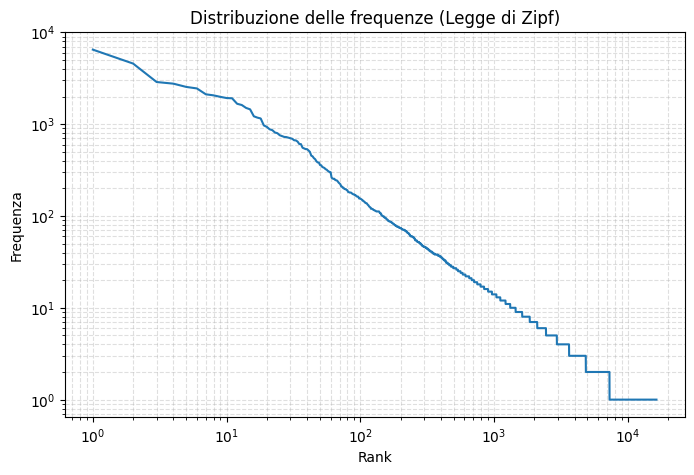

In [31]:
import matplotlib.pyplot as plt

def plot_freq_distribution(vocab):
    """
    vocab = dizionario token -> {"id", "freq"}
    Plotta la distribuzione delle frequenze in scala log-log.
    """

    # estrai tutte le frequenze (escludi PAD/UNK se vuoi)
    freqs = [entry["freq"] for token, entry in vocab.items() if token not in ["<PAD>", "<UNK>"]]

    # ordina le frequenze in ordine decrescente
    freqs_sorted = sorted(freqs, reverse=True)

    # rank dei token
    ranks = range(1, len(freqs_sorted) + 1)

    # plot log-log
    plt.figure(figsize=(8,5))
    plt.loglog(ranks, freqs_sorted)
    plt.title("Distribuzione delle frequenze (Legge di Zipf)")
    plt.xlabel("Rank")
    plt.ylabel("Frequenza")
    plt.grid(True, which="both", linestyle="--", alpha=0.4)
    plt.show()

plot_freq_distribution(vocab)

In scala log-log è una powerlaw, quindi poche parole hanno una grossa frequenza, molte hanno bassa frequenza

Un modello di dimensioni ridotte come il nostro, riesce a gestire un numero di token fino a 30 mila,  
Noi siamo a 16 mila parole , non serve applicare riduzione, è possibile quindi lasciare tutte le parole con frequenza inferiore

**Pruning**  
Eliminare i token rari, alleggerirebbe la matrice in input, ma possono aiutae a imparare sfumature di sarcasmo al modello

**Eventualmente possiamo vedere in seguito, se eliminando queste parole, cambia l'efficienza del modello**

## Encoding
Trasformare quindi i dataset letterari in dataset numerici, in base agli id del vocabolario

In [32]:

def encode_dataset_add_column(df, token2id, tokens_col="tokens", new_col="tokens_int"):
    """
    Aggiunge una colonna `tokens_int` con la sequenza numerica
    per ogni lista di token nella colonna `tokens`.

    Parametri:
        df        : DataFrame con colonna `tokens`
        token2id  : dict token -> id
        tokens_col: nome colonna token (default: 'tokens')
        new_col   : nome colonna con gli ID (default: 'tokens_int')

    Ritorna:
        nuovo_df  : DataFrame con nuova colonna aggiunta
    """

    unk_id = token2id.get("<UNK>")
    if unk_id is None:
        raise ValueError("Errore: manca <UNK> nel vocabolario.")

    def encode(tokens):
        return [token2id.get(t, unk_id) for t in tokens]

    nuovo_df = df.copy()
    nuovo_df[new_col] = nuovo_df[tokens_col].apply(encode)

    return nuovo_df


In [33]:
train_dfMC_encoded  = encode_dataset_add_column(train_dfMC, token2id)
test_dfMC_encoded   = encode_dataset_add_column(test_dfMC, token2id)

train_dfITA_encoded = encode_dataset_add_column(train_dfITA, token2id)
test_dfITA_encoded  = encode_dataset_add_column(test_dfITA, token2id)


In [34]:
# 2) Prepara i DataFrame da visualizzare (scegli le colonne che vuoi)
dfMC_vis  = train_dfMC_encoded[["text", "tokens_int", "label"]].copy()
dfITA_vis = train_dfITA_encoded[["text", "tokens_int", "label"]].copy()

# 3) Visualizza affiancato solo i 2 train
mostra_vocabs_affiancati(
    dfMC_vis,
    dfITA_vis,
    titolo_sx="Train MC",
    titolo_dx="Train IronITA",
    height=380  # puoi cambiarlo se vuoi
)

text,tokens_int,label
"ogni volta che parte un corteo radicale, il centro città diventa un percorso a ostacoli.","[60, 83, 5, 146, 11, 1115, 2447, 3, 7, 439, 351, 497, 11, 904, 12, 7301, 2]",1
"l'acqua è sempre piatta, non curva mai: è la prova più semplice che abbiamo.","[21, 14, 405, 13, 75, 1116, 3, 10, 1322, 129, 15, 13, 6, 750, 37, 394, 5, 186, 2]",0
"perfetto, ora ci manca solo che ti iscrivi alla nasa perché 'ti senti pronto'.","[413, 3, 84, 46, 434, 47, 5, 54, 7302, 48, 1117, 59, 54, 464, 1451, 2]",1
raga ma ogni volta che c'è una notizia sul medio oriente sbucano esperti che ieri litigavano per il rigore in serie a.,"[361, 29, 60, 83, 5, 99, 23, 794, 102, 3640, 4856, 7303, 710, 5, 465, 7304, 16, 7, 2950, 17, 452, 12, 2]",1
notevole come il casco scelga sempre di scendere sugli occhi nei momenti meno opportuni.,"[2104, 33, 7, 4857, 2951, 75, 4, 1452, 1118, 751, 153, 1119, 177, 7305, 2]",1
"scommetto che direbbe 'non fate quelle facce, sembrate usciti da un film drammatico'...","[2105, 5, 2106, 10, 653, 523, 3641, 3, 7306, 2107, 35, 11, 539, 3642, 38]",1
"la cassa oggi sta andando senza blocchi, già è un miracolo.","[6, 2448, 69, 147, 1453, 68, 3643, 3, 133, 13, 11, 844, 2]",0
ho iniziato la serie solo per vedere se davvero è così rivoluzionaria… e per ora la rivoluzione dorme.,"[64, 1120, 6, 452, 47, 16, 164, 24, 65, 13, 57, 4858, 9, 16, 84, 6, 1043, 2108, 2]",1
dire che napoleone era francese dalla nascita è come confondere la biografia con un poster: era corso e la francia è arrivata dopo.,"[85, 5, 7307, 74, 2109, 170, 4859, 13, 33, 2110, 6, 7308, 27, 11, 7309, 15, 74, 1220, 9, 6, 1121, 13, 2449, 80, 2]",1
"è importante ascoltare anche le comunità coinvolte, non solo i grandi nomi del tech.","[13, 344, 613, 42, 25, 1323, 2450, 3, 10, 47, 18, 752, 2111, 32, 4860, 2]",0


Adesso i nostri dataset sono trasformati in vettori, quindi è possibile usarli come input per il per la rete neurale

**Dobbiamo però renderli tutti della stessa lunghezza** = lunghezza fissa e riempio con padding \<PAD\> ID = 0

In [35]:
def max_len_tokens(df):
    return df["tokens"].apply(len).max()

max_MC  = max_len_tokens(train_dfMC_encoded)
max_ITA = max_len_tokens(train_dfITA_encoded)

print("MAX len MC :", max_MC)
print("MAX len ITA:", max_ITA)




MAX len MC : 35
MAX len ITA: 42


Quindi sceglierò come dimensione massima di input = **64 parole**  

Questo permetterà anche di velocizzare l'addestramento della rete, avendo un layer di input ridotto

In [36]:
PAD_ID = token2id.get("<PAD>", 0)   # di solito 0

def pad_dataset(df, max_len, col_in="tokens_int",
                col_ids="input_ids", col_mask="attention_mask"):
    """
    Aggiunge:
      - input_ids      : lista di lunghezza max_len con padding/troncamento
      - attention_mask : 1 per token reali, 0 per pad
    """
    def pad_sequence(seq):
        seq = list(seq)
        if len(seq) >= max_len:
            seq_cut = seq[:max_len]
            mask    = [1] * max_len
        else:
            pad_len = max_len - len(seq)
            seq_cut = seq + [PAD_ID] * pad_len
            mask    = [1] * len(seq) + [0] * pad_len
        return seq_cut, mask

    df_new = df.copy()
    ids_col  = []
    mask_col = []

    for seq in df_new[col_in]:
        ids, m = pad_sequence(seq)
        ids_col.append(ids)
        mask_col.append(m)

    df_new[col_ids]  = ids_col
    df_new[col_mask] = mask_col

    return df_new


MAX_LEN = 64

train_dfMC_pad   = pad_dataset(train_dfMC_encoded,  MAX_LEN)
test_dfMC_pad    = pad_dataset(test_dfMC_encoded,   MAX_LEN)

train_dfITA_pad  = pad_dataset(train_dfITA_encoded, MAX_LEN)
test_dfITA_pad   = pad_dataset(test_dfITA_encoded,  MAX_LEN)


In [37]:
dfMC_vis  = train_dfMC_pad[["text", "input_ids", "label"]].copy()
dfITA_vis = train_dfITA_pad[["text", "input_ids", "label"]].copy()

mostra_vocabs_affiancati(
    dfMC_vis,
    dfITA_vis,
    titolo_sx="Train MC Padded (64)",
    titolo_dx="Train IronITA Padded (64)",
    height=380
)


text,input_ids,label
"ogni volta che parte un corteo radicale, il centro città diventa un percorso a ostacoli.","[60, 83, 5, 146, 11, 1115, 2447, 3, 7, 439, 351, 497, 11, 904, 12, 7301, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",1
"l'acqua è sempre piatta, non curva mai: è la prova più semplice che abbiamo.","[21, 14, 405, 13, 75, 1116, 3, 10, 1322, 129, 15, 13, 6, 750, 37, 394, 5, 186, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",0
"perfetto, ora ci manca solo che ti iscrivi alla nasa perché 'ti senti pronto'.","[413, 3, 84, 46, 434, 47, 5, 54, 7302, 48, 1117, 59, 54, 464, 1451, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",1
raga ma ogni volta che c'è una notizia sul medio oriente sbucano esperti che ieri litigavano per il rigore in serie a.,"[361, 29, 60, 83, 5, 99, 23, 794, 102, 3640, 4856, 7303, 710, 5, 465, 7304, 16, 7, 2950, 17, 452, 12, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",1
notevole come il casco scelga sempre di scendere sugli occhi nei momenti meno opportuni.,"[2104, 33, 7, 4857, 2951, 75, 4, 1452, 1118, 751, 153, 1119, 177, 7305, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",1
"scommetto che direbbe 'non fate quelle facce, sembrate usciti da un film drammatico'...","[2105, 5, 2106, 10, 653, 523, 3641, 3, 7306, 2107, 35, 11, 539, 3642, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",1
"la cassa oggi sta andando senza blocchi, già è un miracolo.","[6, 2448, 69, 147, 1453, 68, 3643, 3, 133, 13, 11, 844, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",0
ho iniziato la serie solo per vedere se davvero è così rivoluzionaria… e per ora la rivoluzione dorme.,"[64, 1120, 6, 452, 47, 16, 164, 24, 65, 13, 57, 4858, 9, 16, 84, 6, 1043, 2108, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",1
dire che napoleone era francese dalla nascita è come confondere la biografia con un poster: era corso e la francia è arrivata dopo.,"[85, 5, 7307, 74, 2109, 170, 4859, 13, 33, 2110, 6, 7308, 27, 11, 7309, 15, 74, 1220, 9, 6, 1121, 13, 2449, 80, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",1
"è importante ascoltare anche le comunità coinvolte, non solo i grandi nomi del tech.","[13, 344, 613, 42, 25, 1323, 2450, 3, 10, 47, 18, 752, 2111, 32, 4860, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",0


## Terminata la pulizia dei dataset
Ecco i dataset ottenuti

In [38]:
train_MC = train_dfMC_pad    # training set MC 
test_MC  = test_dfMC_pad     # test set MC 
train_ITA = train_dfITA_pad  # training set IronITA 
test_ITA  = test_dfITA_pad   # test set IronITA 

In [39]:
# E creo un terzo set dal unione dei due

# Unione
train_all = pd.concat([train_MC, train_ITA], ignore_index=True)

# Shuffle completo
train_all = train_all.sample(frac=1, random_state=42).reset_index(drop=True)

print("Num train_all:", len(train_all))
train_all.head()



test_all = pd.concat([test_MC, test_ITA], ignore_index=True)

test_all = test_all.sample(frac=1, random_state=42).reset_index(drop=True)

print("Num test_all:", len(test_all))





Num train_all: 7971
Num test_all: 1810


In [40]:
from IPython.display import display, HTML

def mostra_dataset(df, titolo="Dataset", height=400):
    """
    Visualizza un singolo DataFrame in una finestra scrollabile,
    nello stesso stile della visualizzazione affiancata.
    """
    html_df = df.to_html(max_rows=None, escape=False, index=False)

    display(HTML(f"""
    <div style="border:1px solid #ccc; padding:10px;">
        <h3>{titolo}</h3>
        <div style="height:{height}px; overflow-y:auto; 
                    border:1px solid #ccc; font-size:13px;">
            {html_df}
        </div>
    </div>
    """))

mostra_dataset(train_all[["text", "input_ids", "label"]], 
               titolo="Train ALL (MC + ITA)",
               height=380)



text,input_ids,label
"i dati satellitari mostrano in modo chiaro la curvatura terrestre, non sono opinioni ma misurazioni verificabili.","[18, 474, 2609, 1395, 17, 204, 595, 6, 1700, 1516, 3, 10, 40, 2127, 29, 2221, 4027, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",0
"ln padania: modena, immigrato spacca sedia addosso alla madre: arrestato","[7284, 2933, 15, 6742, 3, 1113, 4115, 2751, 1334, 48, 2045, 15, 1108, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",0
"ministro, gliela racconto io labuonascuola, quella che fa rima con tfaordinario. sinceramente: ma cosa vi abbiamo fatto di male??","[308, 3, 4279, 4089, 67, 26, 3, 189, 5, 66, 12555, 27, 678, 2, 5727, 15, 29, 78, 286, 186, 70, 4, 224, 19, 19, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",0
account account ma medici sx frontiere perché non li portano a casa loro tutti sti migranti? bello fare i buoni con le ns tasche,"[8, 8, 29, 1584, 6975, 4672, 59, 10, 161, 1833, 12, 118, 135, 43, 1033, 79, 19, 200, 55, 18, 948, 27, 25, 2086, 3069, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",1
"bossi: «il governo monti fa schifo, sono improvvisati». il trota invece, e calderoli, mirabili statisti.","[960, 15, 7, 34, 22, 66, 1035, 3, 40, 14285, 2, 7, 4565, 215, 3, 9, 2928, 3, 14286, 14287, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",1
"cervelliinfuga?initaliasirimpiazzanocoimigranti roba da matti!!certo i nostri rompono i coglioni,migranti votano pd!","[6472, 19, 12939, 2029, 35, 4733, 20, 20, 94, 18, 672, 12940, 18, 1623, 3, 79, 4766, 165, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",0
"che bello, finalmente un'opinione originale… ah no aspetta, è sempre la stessa","[5, 200, 3, 257, 11, 14, 570, 2314, 128, 93, 1276, 3, 13, 75, 6, 402, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",1
è bello vedere che ti sei goduto l'esperienza così tanto.,"[13, 200, 164, 5, 54, 108, 5269, 21, 14, 810, 57, 151, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",0
se volete scoprire un evasore fiscale chiedetegli cosa pensa di mario monti,"[24, 1386, 2023, 11, 6609, 1074, 7159, 78, 272, 4, 61, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",1
"c'e' grande fatica nello scorgere la crescita nei programmi del governo monti, ancor più l'aggettivo sostenibile! bravo nichi piazzapulita","[2056, 288, 1772, 1135, 15919, 6, 1051, 153, 2730, 32, 34, 22, 3, 6485, 37, 21, 14, 15920, 6812, 20, 926, 7224, 463, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",0


Ottengo quindi

- MC = creato da me_________________4000 frasi + 1000 di test_____(più formali e compatte)
- IronITA = estratto da internet_______4000 frasi + 1000 di test_______(più realistiche ma disordinate)
- All = MC + IronITA__________________8000 frasi + 2000 di test  

In [41]:
# Tutti i dataset finali pronti:

train_MC = train_dfMC_pad    # training set MC 
test_MC  = test_dfMC_pad     # test set MC 
train_ITA = train_dfITA_pad  # training set IronITA 
test_ITA  = test_dfITA_pad   # test set IronITA 
train_all = train_all        # training set unito MC + IronITA
test_all  = test_all         # test set unito MC + IronITA

# di cui la struttura di ogni DataFrame è:
#   - text            : testo originale pulito
#   - label           : etichetta 0/1
#   - tokens          : lista di token (stringhe)
#   - tokens_int      : lista di token convertiti in ID (interi)
#   - input_ids       : lista di ID token padded/troncata a MAX_LEN
#   - attention_mask : lista di 1/0 per indicare token reali/padding


# vocabolario totale (MC + IronITA)
vocabolario = vocab # struttura: dict token -> {"token": String, "id": int, "freq": int}       di cui 0 è <PAD> e 1 è <UNK>

# gli id sono messi in ordine crescente a partire da 0 di frequenza decrescente



**fine tokenizzazione** 

# Embedding

Per adesso le parole sono solo numeri interi, la differenza tra le parole è data solo dalla loro differenza,  
non è abbastanza potente per rappresentare la differenza semantica tra le parole.  

Allora si sfruttano le tecniche del **Vector space** , quindi le parole vengono trasformati in vettori n-dimensionali, e la differenza tra le parole dipende da tutte le feature, tipo tramite **differenza del coseno** o **distanza euclidea** che è molto più elaborata e informativa sulla **distanza semantica** tra le parole

**Il vettore di ogni parola è dinamico e viene creato al volo dal LAYER DI EMBEDDING**  
Ogni frase del dataset quindi viene trasformata in questo layer, prima di entrare nella rete neurale ,  
in una matrice di 64 righe per ogni parola, e ogni colonna è il vettore che rappresenta la parola (? righe colonne) facciamo **128 elementi per vettore parola**

**È una trasformazione matematica interna al modello, non un’informazione permanente del dataset.**

## Le feature di ogni parola
Gli elementi di ogni vettore parola, rappresentano la direzione semantica della parola,  
cioè "Il significato reale della parola", che può cambiare da frase a frase  
hai dei capelli bellissimi, sembri un albero  o  hai dei capelli bellissimi, ti donano veramente  
"bellissimi" avrà un significato semantico diverso nelle 2 frasi, **ma lo stesso vettore**,  
QUELLO CHE CAMBIA E' IL RESTO DELLA FRASE, E QUINDI LA DISTANZA TRA I VETTORI DELLE PAROLE

Da cosa dipende il cambio di semantica del "bellissimi" ?   
**Dal resto della frase => cioè la distanza semantica tra le parole**, 
cioè da "sembri un albero" e "ti donano veramente", cambiano la distanza semantica tra le parole e la rete la interpreterà  
in modo diverso in base a questa distanza, decidendo se è ironico o meno
  
**Non possiamo metterlo a mano per ogni parola in ogni frase, sarà il modello a imparare da solo quale peso dare alla parola**
(e quindi nel concreto il modello dovrà interpretare la semantica della frase come se fosse un umano)  
  


In [42]:

# Iniziamo a costruire il modello con PyTorch
import torch

# è una liberia per il deep learning, è come un Numpy potenziato, con funzioni integrate per le reti neurali
# Se si possiede una GPU Invidia, PyTorch può sfruttarla per accelerare i calcoli 
# (gestisce ad alto livello CUDA, difficile da usare a basso livello)

import torch.nn as nn   # Modulo contenente le funzioni di rete neurale

**Costurimo la classe del embedding layers**
Sfruttiamo funzioni gia presenti in torch, ottimizzate   
  
Scriviamo la classe EmbeddingLayer (scelto io, sarà il nostro embedding layer)  
Ereditiamo e istanziamo la classe padre **token_embedding**  

Ereditiamo diverse funzioni, che andiamo a sovrascrivere con i nostri parametri :  
  
#### COSTRUISCE LA MATRICE dim_vocabolario x dim_wordVector = MATRICE DI EMBEDDING  
==> Quindi ogni riga sarà una parola del vocabolario , e per ogni parola avrò il suo word vector (abbiamo detto di 128 features)  
==> Sarà inizializzato a con valori casuali piccoli, abbiamo detto che è la RETE CHE DEVE IMPARARE LA SEMANTICA/DIREZIONE DELLE PAROLE  
==> l'indice di padding = 0 verrà lasciato tutti 0  
  
Quindi otterrò la matrice di pesi che dovranno essere addestrati, in modo che la rete capisca la semantica  
All'inizio tutte le parole hanno significato semantico casuale, puntano in direzione casuale

#### POSITIONAL ENCODING
I transfomer non hanno memoria sequenziale, non ricordano esattamente dove stanno le parole  
(la frase infatti non viene letta in modo ordinato ma parallelo parola per parola)  
  
uomo mangia cane (ironico) sarebbe uguale a cane mangia uomo (non ironica e tragica)

**MATRICE FRASE - POSIZIONALE**  
==> Costruisco un unica matrice per tutte le frasi, sarà duplicata per ogni frase  
==> La matrice sarà 64x128 ogni riga rappresenta la posizione di una frase   
==> la riga lunga 128 elementi sarà la rappresentazione l'informazione della posizione (es pos 1 -> [1,4,5,1]) in R128   
==> questa infrmazione verrà **sommata alla matrice di embedding**, aggiungo l'informazione alla matrice delle frasi  
==> anche questa matrice viene addestrata, per trovare i pesi ideali per rappresentare la posizione della parola  

  
**Risultato EMBEDDED + POSIZIONALE**  
Uno stack di 4000 frasi, ogni frase rappresentata da una matrice 64x128  
che contiene le informazioni sulla parola e su la posizione all'interno della frase



### Padding Mask
In futuro non vogliamo che le parole PAD facciano parte dei calcoli delle diverse componenti successive,  
Quindi costruiamo una maskera di padding, che verrà data al tensore, apposta per ricordare per ogni matrice frase,  
QUALI PAROLE SONO PADDING E QUALI NO  
  
Otteniamo quindi una matrice lunga quanto il numero di frasi nel dataset (4000) ogni riga corrisponde a una frase  
lunga 64, per ogni parola ho 1 se è una parola vera e 0 se è padding in fondo


  
LA FUNZIONE FORWARD APPLICA LE COSE CHE DEVE FARE L'EMBEDDING LAYER, METTENDO DENTRO LE MATRICI I VALORI REALI

In [43]:
# Embedding layer
# gli passiamo nn.Module, in modo da ereditare le funzionalità di PyTorch

class EmbeddingLayer(nn.Module):

    # Istanziamo con i parametri di base:

    # dimensione vocabolario = 16397 (con PAD e UNK)
    # dimensione word vector = 128
    # dimensione frase = 64          (con padding)
    # padding_idx = 0                (ID del token di padding)

    def __init__(self, dim_vocabolario, dim_wordVector, dim_frase, padding_idx=0):
        super().__init__()

        # Ereditiamo il costruttore della superclasse nn.Module   super().    __init__()
        # Sovrascriviamo le funzioni che fanno il lavoro del embedding layer



        # nn.Embedding genera la matrice di embedding (dim_vocabolario x dim_wordVector) inizializzata casualmente
        self.token_embedding = nn.Embedding(
                num_embeddings=dim_vocabolario,
                embedding_dim=dim_wordVector,
                padding_idx=padding_idx
            )
        # self.token_embedding l'abbiamo definita nel costruttore, ha generato una matrice di embedding casuale 16397x128 RANDOM
        # non abbiamo dato il vocabolario, ma solo la dimensione (dim_vocabolario)
        

        # nn.embedding genera la matrice di posizioni (dim_frase x dim_wordVector) per adesso null (solo struttura)
        self.pos_embedding = nn.Embedding(
                num_embeddings=dim_frase,     
                embedding_dim=dim_wordVector
        )
        # self.pos_embedding l'abbiamo definita nel costruttore, ha generato una matrice di posizioni 64x128 
        # è una unica tabella globale per tutte le frasi, indica la posizione delle parole nella frase (0,1,2,...63)


        self.dim_frase = dim_frase
        self.dim_wordVector = dim_wordVector

        



    # Funzione forward: prende in input i token ID e SVOLGE L'EMBEDDING
    # fornisco input_ids cioè le frasi del dataset, tokenizzate e convertite in ID [1,4,2,20,34,...,0,0,0] (con padding)

    ## !! Buona abitudine = passare un tensore PyTorch, non una lista Python !!
    '''
        Come trasformare la mia lista in tensore PyTorch:
            sent_list = list(train_all["input_ids"].values)         # lista di liste frasi tokenizzate e convertite in ID
            input_ids_tensor = torch.tensor(sent_list, dtype=torch.long)  # tensore PyTorch di tipo long (interi)
            embeddings = embedding_layer.forward(input_ids_tensor)   # passo il tensore alla funzione forward
    
    '''

    def forward(self, input_ids):

        '''
            Tensore passato in input (4000x64 paddate):

                    0    [12, 83, 5, 146, 0, 0, ..., 0]
                    1    [21, 14, 405, 13, 99, 0, ..., 0]
                    2    [...]
                    ...

        '''

        # frasi training set
        batch_size, seq_len = input_ids.size()  # ottengo dimensioni batch (numero frasi 4000) e lunghezza sequenza (64 fissa)

        
        # Fornendo la lista delle frasi tokenizzate e convertite in ID (input_ids), scorre la lista e per ogni ID
        # prende la riga corrispondente al ID nella matrice di embedding
        # token_emb è un tensore, una pila di matrici 64x128 (4000 frasi nel training set, quindi uno stack di 4000 matrici)
        token_emb = self.token_embedding(input_ids)  


        # creo un array per le posizioni delle parole nella frase
        positions = torch.arange(seq_len, device=input_ids.device)   # [0,1,2,...,63] 
        positions = positions.unsqueeze(0).expand(batch_size, seq_len)  # [[0,1,2,...,63], [0,1,2,...,63], ...] x 4000 frasi

        # trasforma ogni elemento di positions nella corrispondente riga della matrice di posizioni
        # cioè pos i viene trasformato in un vettore di 128, per ogni i da 0 a 63
        pos_emb = self.pos_embedding(positions)

        # SOMMA I WordVectors + PosVectors , quindi informazioni sulla parola + informazioni sulla posizione
        # per ogni frase, quindi ottengo 4000 matrici 64x128
        embeddings = token_emb + pos_emb


        # GENERO LA PADDING MASK
        #    1 = parola vera, 0 = PAD
        mask = (input_ids != 0).long()  


        return token_emb,pos_emb,embeddings,mask

    

In [44]:
dim_vocabolario = len(vocabolario)   # dovrebbe essere 16397
dim_wordVector  = 128
dim_frase       = 64
padding_idx     = 0

embedding_layer = EmbeddingLayer(
    dim_vocabolario=dim_vocabolario,
    dim_wordVector=dim_wordVector,
    dim_frase=dim_frase,
)

## Faccio la prova con train_MC

 # Prendo tutte le frasi del training set MC (lista di liste)
sent_list_MC = list(train_MC["input_ids"].values)

# Converto in tensore PyTorch [B, 64]
input_ids_tensor_MC = torch.tensor(sent_list_MC, dtype=torch.long)

with torch.no_grad():   # per ora niente backprop
    token_emb, pos_emb, embeddings, mask = embedding_layer(input_ids_tensor_MC)

print("Shape token_emb:", token_emb.shape)
print("Shape pos_emb:", pos_emb.shape)
print("mask shape:", mask.shape)



Shape token_emb: torch.Size([3995, 64, 128])
Shape pos_emb: torch.Size([3995, 64, 128])
mask shape: torch.Size([3995, 64])


In [45]:
from IPython.display import display, HTML
import pandas as pd
import numpy as np

def mostra_embedding_frase_scroll(idx, input_ids_tensor, token_emb, df_orig, height=420):
    """
    idx: indice frase
    input_ids_tensor: [B, 64]
    token_emb: [B, 64, 128]
    df_orig: DataFrame originale (train_MC)
    height: altezza box scrollabile
    """

    ids = input_ids_tensor[idx].tolist()                # [64]
    emb = token_emb[idx].detach().cpu().numpy()         # [64, 128]
    tokens = df_orig.iloc[idx]["tokens"]
    text = df_orig.iloc[idx]["text"]
    label = df_orig.iloc[idx]["label"]

    seq_len = emb.shape[0]
    cols = [f"d{j}" for j in range(emb.shape[1])]       # d0..d127

    df_emb = pd.DataFrame(emb, columns=cols)
    df_emb.insert(0, "pos", list(range(seq_len)))
    df_emb.insert(1, "token_id", ids)

    padded_tokens = list(tokens) + ["<PAD>"] * (seq_len - len(tokens))
    df_emb.insert(2, "token", padded_tokens[:seq_len])

    html = df_emb.to_html(index=False)

    display(HTML(f"""
    <h4>Frase {idx} – Label: {label}</h4>
    <p><b>Testo:</b> {text}</p>

    <div style="height:{height}px; overflow-y:auto; border:1px solid #aaa;">
        {html}
    </div>
    """))

mostra_embedding_frase_scroll(0, input_ids_tensor_MC, token_emb, train_MC)



pos,token_id,token,d0,d1,d2,d3,d4,d5,d6,d7,d8,d9,d10,d11,d12,d13,d14,d15,d16,d17,d18,d19,d20,d21,d22,d23,d24,d25,d26,d27,d28,d29,d30,d31,d32,d33,d34,d35,d36,d37,d38,d39,d40,d41,d42,d43,d44,d45,d46,d47,d48,d49,d50,d51,d52,d53,d54,d55,d56,d57,d58,d59,d60,d61,d62,d63,d64,d65,d66,d67,d68,d69,d70,d71,d72,d73,d74,d75,d76,d77,d78,d79,d80,d81,d82,d83,d84,d85,d86,d87,d88,d89,d90,d91,d92,d93,d94,d95,d96,d97,d98,d99,d100,d101,d102,d103,d104,d105,d106,d107,d108,d109,d110,d111,d112,d113,d114,d115,d116,d117,d118,d119,d120,d121,d122,d123,d124,d125,d126,d127
0,60,ogni,-0.056292,-0.848165,0.641611,0.460249,-0.139039,1.018945,2.004484,-0.762788,1.115346,-0.696011,-0.296762,1.196247,0.290196,1.040862,-1.137849,-0.100133,0.481739,-0.028170,0.501134,1.605099,1.194627,0.792919,-1.617462,0.484584,2.023876,-0.839331,0.973961,-0.481571,-0.200148,-0.596694,-0.463728,-1.190003,-0.187786,1.297936,0.603224,-1.359097,1.616288,-0.620697,-0.490854,0.074960,1.335141,-2.275549,-0.378544,-0.172285,1.650829,-0.205662,-0.162772,-1.958241,-0.555453,-0.242003,0.075837,1.429133,-0.371529,0.743221,0.078254,1.058871,-0.992717,-0.347268,-0.556715,0.552234,0.995075,-0.902082,0.035400,-0.770595,-0.812472,-1.433265,0.643733,0.210257,-1.232871,-0.540109,0.139405,1.253525,0.112174,-0.745311,-1.865826,0.828531,0.299266,0.231972,1.036533,-0.625025,0.786133,-2.132986,-0.854365,-0.221945,-2.111887,0.525173,0.464117,-0.287556,0.235972,0.220443,2.214717,0.588519,-2.442410,1.545449,1.579650,0.917809,1.684747,0.014399,0.682875,0.393233,0.357982,-0.599053,1.238643,-1.329473,1.202426,1.515405,-0.449691,0.315556,-0.277854,-2.240551,0.264235,-2.150981,1.038443,0.209140,-0.502258,-1.194423,-0.553784,0.906202,1.187124,-0.907166,-1.887242,-0.548653,0.184194,1.177799,1.725248,1.234632,-0.272560,0.136318
1,83,volta,1.363965,-0.362821,-1.164607,0.483113,-1.296174,-2.633803,-0.018803,-0.375710,-0.086979,0.950917,-0.849959,-0.559991,0.692838,-0.053529,-1.259146,1.319272,1.977833,0.059183,-0.568208,0.416183,-0.556675,1.262234,0.973164,-0.912879,-0.828935,1.941130,-0.613794,0.123021,-1.034886,-0.949593,0.484988,-0.194968,0.125412,0.124056,-0.921628,0.329458,0.282575,0.169050,0.361069,-0.719422,1.578259,-0.970026,-1.030546,-0.419284,-0.344674,-0.028694,0.347909,-3.185066,-0.116020,-0.162345,-1.729664,0.207188,2.225490,1.463467,-0.163285,0.066373,0.129781,0.671857,0.058483,-0.222028,-0.324150,1.902408,0.768859,-0.239583,0.519693,-0.267805,-0.753512,0.575975,0.204076,1.363860,0.254605,-1.208854,-0.825705,-2.495970,1.726671,-0.890598,0.467763,-0.806965,1.013948,0.449132,-0.816929,0.199870,0.416822,-1.103254,0.194358,-0.771908,-2.133082,0.189956,-0.215180,-0.155335,1.502494,-0.359744,0.508484,0.959474,-0.217967,2.602433,0.875315,0.587803,-0.723694,0.993493,0.494934,-1.480819,0.150011,1.263886,-0.524564,-0.031703,-1.537854,-1.201746,0.763109,-1.450125,0.614979,0.471599,-0.345996,0.457335,0.254297,0.020541,-0.346504,-0.675128,0.970906,0.138052,-0.670013,0.938411,-1.483206,-0.663157,0.487939,-0.136327,0.055504,1.155049
2,5,che,0.317113,0.548747,0.218593,1.221391,-0.147438,0.162131,-0.106528,-0.902441,-0.430125,-0.322591,2.306042,0.678326,-1.875430,0.942832,2.151204,0.009163,0.977168,-0.015587,-0.249677,2.583833,-0.812497,2.791789,1.671975,1.383599,-0.080538,0.857137,0.464628,-0.025025,-0.634651,0.169799,-0.864626,-1.718053,-0.974504,0.345255,-0.546398,0.365464,0.040261,0.941197,1.055801,0.161471,-0.125661,0.666520,1.141792,-0.659744,0.764591,0.302466,1.118878,0.799256,0.018205,-0.726611,0.059972,1.469040,-0.738261,-0.447594,0.165483,-0.007447,2.062351,-0.753017,-1.060428,-0.605507,-2.038793,0.863115,-1.464083,-0.669977,-0.425920,1.478473,0.770312,0.139113,-0.644247,1.692466,0.660759,0.542565,-0.384644,-0.217877,2.276787,-1.309226,-0.660809,1.165242,-0.543330,-0.845175,0.605223,-0.759170,-2.057919,-0.815405,-1.544346,0.676001,0.955849,-1.476157,1.889622,-1.071221,1.516910,-1.325639,1.489003,0.304184,1.039531,-0.141413,2.388577,1.908223,1.489567,0.404207,-0.496414,-0.369696,0.033416,0.835879,-1.840311,-1.

In [46]:
from IPython.display import display, HTML
import pandas as pd
import numpy as np

def mostra_pos_embedding_frase_scroll(idx, pos_emb, df_orig, height=420):
    """
    idx: indice frase
    pos_emb: [B, 64, 128]
    df_orig: DataFrame originale (train_MC)
    height: altezza box scrollabile
    """

    emb = pos_emb[idx].detach().cpu().numpy()     # [64, 128]
    text = df_orig.iloc[idx]["text"]
    label = df_orig.iloc[idx]["label"]

    seq_len = emb.shape[0]
    cols = [f"d{j}" for j in range(emb.shape[1])]  # d0..d127

    df_emb = pd.DataFrame(emb, columns=cols)
    df_emb.insert(0, "pos", list(range(seq_len)))   # QUI la posizione è il vero "token"

    html = df_emb.to_html(index=False)

    display(HTML(f"""
    <h4>POS_EMB – Frase {idx} – Label: {label}</h4>
    <p><b>Testo:</b> {text}</p>

    <div style="height:{height}px; overflow-y:auto; border:1px solid #aaa;">
        {html}
    </div>
    """))

mostra_pos_embedding_frase_scroll(0, pos_emb, train_MC)
mostra_pos_embedding_frase_scroll(1, pos_emb, train_MC)

# IDENTICA PER OGNI FRASE, QUINDI HO 4000 MATRICI IDENTICHE PER OGNI FRASE DEL TRAINING SET

pos,d0,d1,d2,d3,d4,d5,d6,d7,d8,d9,d10,d11,d12,d13,d14,d15,d16,d17,d18,d19,d20,d21,d22,d23,d24,d25,d26,d27,d28,d29,d30,d31,d32,d33,d34,d35,d36,d37,d38,d39,d40,d41,d42,d43,d44,d45,d46,d47,d48,d49,d50,d51,d52,d53,d54,d55,d56,d57,d58,d59,d60,d61,d62,d63,d64,d65,d66,d67,d68,d69,d70,d71,d72,d73,d74,d75,d76,d77,d78,d79,d80,d81,d82,d83,d84,d85,d86,d87,d88,d89,d90,d91,d92,d93,d94,d95,d96,d97,d98,d99,d100,d101,d102,d103,d104,d105,d106,d107,d108,d109,d110,d111,d112,d113,d114,d115,d116,d117,d118,d119,d120,d121,d122,d123,d124,d125,d126,d127
0,-1.441054,0.210022,0.787618,-0.548569,0.702581,-1.138579,0.089764,2.412457,-0.843441,0.053671,-0.808655,0.328763,0.159520,-1.300415,0.788451,-0.088764,-1.000588,-0.142393,0.770300,0.381755,-0.468907,0.395308,1.909949,0.135567,0.218132,1.500932,-0.040207,-0.469181,0.611553,0.712605,0.706609,0.948128,-0.280599,-0.041565,-0.297625,0.713623,0.355837,1.292890,-0.778656,0.212407,-0.617650,-2.222238,0.375297,0.698773,-0.437191,0.050074,-1.456995,0.739014,0.173888,1.029654,-1.712587,0.442881,-0.229686,1.322921,1.360160,0.138403,-0.269216,-0.187192,0.549252,-1.862477,0.979086,1.092777,-0.941563,1.459196,1.437338,-1.318174,1.857887,1.389455,2.147717,-0.341914,0.591813,-0.491293,1.287989,-0.700333,0.140313,1.697679,0.371751,0.433993,1.542470,0.415977,-0.430515,-1.012315,-0.852070,0.620701,-0.243310,1.418536,0.334231,-0.212062,0.266376,-0.462215,0.061425,0.543325,-1.008600,2.325737,0.170123,-0.765038,0.625958,0.467586,1.230682,0.559848,-0.508586,1.035958,1.338222,-0.268388,-0.214797,-0.452651,1.026412,-0.157604,1.190132,-0.999804,0.748038,-0.471440,-0.062161,-0.647389,-2.895793,-0.151953,-1.472871,-0.711891,-0.593821,-1.340925,-1.411777,0.519921,-1.332476,0.905948,-0.222363,0.958558,1.525420,-0.120621
1,-0.600330,-0.933267,-0.426895,1.892819,2.125865,0.957691,0.774852,-0.159247,-0.466860,0.160133,-1.997308,0.145334,-1.246248,0.324762,-0.318770,0.449835,-0.240893,1.080020,0.290600,2.806928,-0.101545,0.309949,-1.391064,2.294787,1.000164,1.233696,0.281291,-0.441998,-1.384116,1.014269,-0.586529,0.184417,0.694780,-1.550818,-0.092630,1.223363,-1.110959,-1.049881,-0.295269,2.331736,1.664425,-0.632109,-0.546318,0.170474,0.016510,-0.605191,1.201213,-0.083044,1.100954,0.511953,1.049154,0.371892,2.015305,-0.174242,0.980987,1.001585,-0.753127,-0.931170,-0.589808,0.878787,-1.245986,1.284258,-0.063970,-0.221240,1.348763,-0.733255,-0.756107,-0.341035,-1.507072,-0.705993,-0.862280,-0.069740,-0.558068,-0.871178,-0.998819,0.654381,-0.162345,-0.767300,1.533146,0.951523,-1.504112,-0.143518,-2.044562,1.070628,-0.741304,-2.051921,0.817462,-1.115595,-1.230191,-0.003772,-0.029255,0.013467,0.496696,0.525773,1.415373,0.608653,0.033601,-0.800965,0.287582,1.798837,1.030193,0.065277,1.002297,0.251214,0.837064,-0.096940,-1.137084,0.035261,-0.156818,-0.081328,-0.073050,0.990342,-1.293595,-0.372504,1.350975,0.692781,-0.764222,0.024739,2.190330,0.222688,-0.913698,-0.295485,-1.034530,0.215324,0.312103,0.519316,2.143206,0.920767
2,1.090699,-1.167328,-1.533822,-0.298017,0.677299,-0.143658,-1.776095,-0.905046,0.112796,0.494002,0.687640,-0.367281,2.315321,-1.260807,2.056342,0.748150,-0.796396,-0.575631,0.440089,-0.987146,1.607127,-0.783448,0.915698,1.716527,-0.433120,-0.895897,0.038289,-0.063430,-0.474764,-2.673691,0.646114,-0.807779,-0.213536,-0.252538,-0.663270,0.276777,-0.445197,1.224948,-2.384012,0.855516,-1.726202,1.693637,1.242497,0.206837,-0.413277,0.290188,-0.592993,-0.542594,0.058066,0.860412,0.250051,0.830240,1.926026,-0.153679,0.643375,0.810024,-0.709086,-1.658602,2.240927,-0.657574,0.292181,-0.166968,-1.225566,-0.936506,1.398936,2.042624,0.882696,0.555475,1.327805,-0.449931,0.482257,0.293904,-0.067262,-0.987861,0.311540,1.378512,0.131505,1.442671,-0.210461,-1.625415,-1.300212,-1.043740,-0.879981,-0.762403,-0.572166,-0.194631,-0.578364,1.057944,0.444456,-0.424585,-2.448399,0.993922,-1.339947,0.515770,1.184946,0.728567,1.421880,-0.902338,-3.217181,0.955996,-1.394958,0.422992,2.770499,-2.627212,-0.725716,1.572406,1.474136,-2.291654,1.129380,

pos,d0,d1,d2,d3,d4,d5,d6,d7,d8,d9,d10,d11,d12,d13,d14,d15,d16,d17,d18,d19,d20,d21,d22,d23,d24,d25,d26,d27,d28,d29,d30,d31,d32,d33,d34,d35,d36,d37,d38,d39,d40,d41,d42,d43,d44,d45,d46,d47,d48,d49,d50,d51,d52,d53,d54,d55,d56,d57,d58,d59,d60,d61,d62,d63,d64,d65,d66,d67,d68,d69,d70,d71,d72,d73,d74,d75,d76,d77,d78,d79,d80,d81,d82,d83,d84,d85,d86,d87,d88,d89,d90,d91,d92,d93,d94,d95,d96,d97,d98,d99,d100,d101,d102,d103,d104,d105,d106,d107,d108,d109,d110,d111,d112,d113,d114,d115,d116,d117,d118,d119,d120,d121,d122,d123,d124,d125,d126,d127
0,-1.441054,0.210022,0.787618,-0.548569,0.702581,-1.138579,0.089764,2.412457,-0.843441,0.053671,-0.808655,0.328763,0.159520,-1.300415,0.788451,-0.088764,-1.000588,-0.142393,0.770300,0.381755,-0.468907,0.395308,1.909949,0.135567,0.218132,1.500932,-0.040207,-0.469181,0.611553,0.712605,0.706609,0.948128,-0.280599,-0.041565,-0.297625,0.713623,0.355837,1.292890,-0.778656,0.212407,-0.617650,-2.222238,0.375297,0.698773,-0.437191,0.050074,-1.456995,0.739014,0.173888,1.029654,-1.712587,0.442881,-0.229686,1.322921,1.360160,0.138403,-0.269216,-0.187192,0.549252,-1.862477,0.979086,1.092777,-0.941563,1.459196,1.437338,-1.318174,1.857887,1.389455,2.147717,-0.341914,0.591813,-0.491293,1.287989,-0.700333,0.140313,1.697679,0.371751,0.433993,1.542470,0.415977,-0.430515,-1.012315,-0.852070,0.620701,-0.243310,1.418536,0.334231,-0.212062,0.266376,-0.462215,0.061425,0.543325,-1.008600,2.325737,0.170123,-0.765038,0.625958,0.467586,1.230682,0.559848,-0.508586,1.035958,1.338222,-0.268388,-0.214797,-0.452651,1.026412,-0.157604,1.190132,-0.999804,0.748038,-0.471440,-0.062161,-0.647389,-2.895793,-0.151953,-1.472871,-0.711891,-0.593821,-1.340925,-1.411777,0.519921,-1.332476,0.905948,-0.222363,0.958558,1.525420,-0.120621
1,-0.600330,-0.933267,-0.426895,1.892819,2.125865,0.957691,0.774852,-0.159247,-0.466860,0.160133,-1.997308,0.145334,-1.246248,0.324762,-0.318770,0.449835,-0.240893,1.080020,0.290600,2.806928,-0.101545,0.309949,-1.391064,2.294787,1.000164,1.233696,0.281291,-0.441998,-1.384116,1.014269,-0.586529,0.184417,0.694780,-1.550818,-0.092630,1.223363,-1.110959,-1.049881,-0.295269,2.331736,1.664425,-0.632109,-0.546318,0.170474,0.016510,-0.605191,1.201213,-0.083044,1.100954,0.511953,1.049154,0.371892,2.015305,-0.174242,0.980987,1.001585,-0.753127,-0.931170,-0.589808,0.878787,-1.245986,1.284258,-0.063970,-0.221240,1.348763,-0.733255,-0.756107,-0.341035,-1.507072,-0.705993,-0.862280,-0.069740,-0.558068,-0.871178,-0.998819,0.654381,-0.162345,-0.767300,1.533146,0.951523,-1.504112,-0.143518,-2.044562,1.070628,-0.741304,-2.051921,0.817462,-1.115595,-1.230191,-0.003772,-0.029255,0.013467,0.496696,0.525773,1.415373,0.608653,0.033601,-0.800965,0.287582,1.798837,1.030193,0.065277,1.002297,0.251214,0.837064,-0.096940,-1.137084,0.035261,-0.156818,-0.081328,-0.073050,0.990342,-1.293595,-0.372504,1.350975,0.692781,-0.764222,0.024739,2.190330,0.222688,-0.913698,-0.295485,-1.034530,0.215324,0.312103,0.519316,2.143206,0.920767
2,1.090699,-1.167328,-1.533822,-0.298017,0.677299,-0.143658,-1.776095,-0.905046,0.112796,0.494002,0.687640,-0.367281,2.315321,-1.260807,2.056342,0.748150,-0.796396,-0.575631,0.440089,-0.987146,1.607127,-0.783448,0.915698,1.716527,-0.433120,-0.895897,0.038289,-0.063430,-0.474764,-2.673691,0.646114,-0.807779,-0.213536,-0.252538,-0.663270,0.276777,-0.445197,1.224948,-2.384012,0.855516,-1.726202,1.693637,1.242497,0.206837,-0.413277,0.290188,-0.592993,-0.542594,0.058066,0.860412,0.250051,0.830240,1.926026,-0.153679,0.643375,0.810024,-0.709086,-1.658602,2.240927,-0.657574,0.292181,-0.166968,-1.225566,-0.936506,1.398936,2.042624,0.882696,0.555475,1.327805,-0.449931,0.482257,0.293904,-0.067262,-0.987861,0.311540,1.378512,0.131505,1.442671,-0.210461,-1.625415,-1.300212,-1.043740,-0.879981,-0.762403,-0.572166,-0.194631,-0.578364,1.057944,0.444456,-0.424585,-2.448399,0.993922,-1.339947,0.515770,1.184946,0.728567,1.421880,-0.902338,-3.217181,0.955996,-1.394958,0.422992,2.770499,-2.627212,-0.725716,1.572406,1.474136,-2.291654,1.129380,

In [47]:
from IPython.display import display, HTML
import pandas as pd
import numpy as np

def mostra_embeddings_frase_scroll(idx, embeddings, df_orig, height=420):
    """
    idx: indice frase
    embeddings: [B, 64, 128]
    df_orig: DataFrame originale (train_MC)
    height: altezza box scrollabile
    """

    emb = embeddings[idx].detach().cpu().numpy()   # [64, 128]
    tokens = df_orig.iloc[idx]["tokens"]
    text = df_orig.iloc[idx]["text"]
    label = df_orig.iloc[idx]["label"]

    seq_len = emb.shape[0]
    cols = [f"d{j}" for j in range(emb.shape[1])]  # d0..d127

    df_emb = pd.DataFrame(emb, columns=cols)
    df_emb.insert(0, "pos", list(range(seq_len)))

    padded_tokens = list(tokens) + ["<PAD>"] * (seq_len - len(tokens))
    df_emb.insert(1, "token", padded_tokens[:seq_len])

    html = df_emb.to_html(index=False)

    display(HTML(f"""
    <h4>EMBEDDINGS (Parola + Posizione) – Frase {idx} – Label: {label}</h4>
    <p><b>Testo:</b> {text}</p>

    <div style="height:{height}px; overflow-y:auto; border:1px solid #aaa;">
        {html}
    </div>
    """))
    
mostra_embeddings_frase_scroll(0, embeddings, train_MC)


pos,token,d0,d1,d2,d3,d4,d5,d6,d7,d8,d9,d10,d11,d12,d13,d14,d15,d16,d17,d18,d19,d20,d21,d22,d23,d24,d25,d26,d27,d28,d29,d30,d31,d32,d33,d34,d35,d36,d37,d38,d39,d40,d41,d42,d43,d44,d45,d46,d47,d48,d49,d50,d51,d52,d53,d54,d55,d56,d57,d58,d59,d60,d61,d62,d63,d64,d65,d66,d67,d68,d69,d70,d71,d72,d73,d74,d75,d76,d77,d78,d79,d80,d81,d82,d83,d84,d85,d86,d87,d88,d89,d90,d91,d92,d93,d94,d95,d96,d97,d98,d99,d100,d101,d102,d103,d104,d105,d106,d107,d108,d109,d110,d111,d112,d113,d114,d115,d116,d117,d118,d119,d120,d121,d122,d123,d124,d125,d126,d127
0,ogni,-1.497346,-0.638143,1.429229,-0.088320,0.563542,-0.119633,2.094248,1.649669,0.271905,-0.642341,-1.105417,1.525010,0.449716,-0.259553,-0.349397,-0.188897,-0.518849,-0.170563,1.271434,1.986854,0.725720,1.188227,0.292487,0.620152,2.242008,0.661601,0.933755,-0.950752,0.411404,0.115911,0.242881,-0.241875,-0.468385,1.256371,0.305598,-0.645474,1.972125,0.672194,-1.269510,0.287367,0.717491,-4.497787,-0.003247,0.526487,1.213639,-0.155588,-1.619767,-1.219228,-0.381566,0.787650,-1.636750,1.872014,-0.601215,2.066142,1.438414,1.197274,-1.261932,-0.534460,-0.007463,-1.310243,1.974161,0.190695,-0.906163,0.688600,0.624866,-2.751439,2.501620,1.599712,0.914846,-0.882023,0.731218,0.762231,1.400163,-1.445643,-1.725513,2.526211,0.671017,0.665964,2.579002,-0.209048,0.355619,-3.145301,-1.706435,0.398757,-2.355197,1.943708,0.798348,-0.499619,0.502348,-0.241772,2.276142,1.131844,-3.451010,3.871186,1.749773,0.152771,2.310705,0.481985,1.913557,0.953081,-0.150604,0.436905,2.576865,-1.597862,0.987628,1.062755,0.576721,0.157951,0.912278,-3.240355,1.012273,-2.622422,0.976283,-0.438249,-3.398051,-1.346375,-2.026655,0.194312,0.593303,-2.248091,-3.299020,-0.028731,-1.148282,2.083747,1.502885,2.193191,1.252860,0.015697
1,volta,0.763635,-1.296088,-1.591502,2.375931,0.829691,-1.676112,0.756050,-0.534957,-0.553840,1.111050,-2.847268,-0.414656,-0.553410,0.271233,-1.577916,1.769107,1.736939,1.139203,-0.277608,3.223111,-0.658220,1.572183,-0.417901,1.381908,0.171229,3.174825,-0.332504,-0.318978,-2.419002,0.064676,-0.101541,-0.010550,0.820192,-1.426762,-1.014258,1.552821,-0.828384,-0.880831,0.065800,1.612314,3.242684,-1.602135,-1.576864,-0.248810,-0.328164,-0.633885,1.549122,-3.268110,0.984934,0.349608,-0.680510,0.579080,4.240794,1.289224,0.817701,1.067958,-0.623347,-0.259313,-0.531325,0.656758,-1.570137,3.186666,0.704889,-0.460824,1.868455,-1.001059,-1.509619,0.234940,-1.302996,0.657867,-0.607675,-1.278594,-1.383773,-3.367148,0.727853,-0.236217,0.305418,-1.574265,2.547094,1.400654,-2.321041,0.056352,-1.627740,-0.032625,-0.546946,-2.823829,-1.315620,-0.925639,-1.445371,-0.159108,1.473239,-0.346277,1.005180,1.485247,1.197406,3.211085,0.908917,-0.213162,-0.436113,2.792331,1.525126,-1.415542,1.152308,1.515100,0.312499,-0.128644,-2.674938,-1.166485,0.606291,-1.531452,0.541929,1.461940,-1.639591,0.084831,1.605272,0.713322,-1.110726,-0.650389,3.161236,0.360740,-1.583711,0.642926,-2.517736,-0.447833,0.800042,0.382989,2.198711,2.075816
2,che,1.407812,-0.618581,-1.315229,0.923374,0.529861,0.018472,-1.882622,-1.807487,-0.317328,0.171410,2.993682,0.311044,0.439891,-0.317975,4.207546,0.757313,0.180772,-0.591219,0.190413,1.596688,0.794630,2.008341,2.587673,3.100127,-0.513658,-0.038760,0.502917,-0.088455,-1.109414,-2.503891,-0.218512,-2.525833,-1.188040,0.092717,-1.209668,0.642241,-0.404936,2.166145,-1.328211,1.016986,-1.851863,2.360157,2.384289,-0.452907,0.351314,0.592654,0.525885,0.256662,0.076271,0.133800,0.310023,2.299280,1.187765,-0.601273,0.808858,0.802578,1.353266,-2.411619,1.180500,-1.263081,-1.746613,0.696147,-2.689649,-1.606483,0.973016,3.521097,1.653009,0.694588,0.683558,1.242535,1.143016,0.836469,-0.451906,-1.205737,2.588327,0.069286,-0.529304,2.607913,-0.753791,-2.470590,-0.694989,-1.802910,-2.937899,-1.577808,-2.116511,0.481370,0.377485,-0.418212,2.334078,-1.495806,-0.931489,-0.331716,0.149056,0.819954,2.224477,0.587154,3.810457,1.005885,-1.727615,1.360203,-1.891371,0.053296,2.803914,-1.791332,-2.566027,0.254752,2.184529,-0.459891,2

**DI STANDARD : VIENE SOMMATA LA POSIZIONE ANCHE AI PADDINGS**
(nei modelli reali lo fanno, tengono anche l'informazione della posizione dei paddings, può tornare utile, o comunque  
i paddings verranno ignorati più avanti, non crea nessun disturbo)

**Visualizzo la maschera di MC**

In [48]:
import torch
from IPython.display import display, HTML

# Visualizza la padding mask per il dataset MC
# (ricrea input_ids_tensor_MC se non esiste, poi costruisce una tabella scrollabile)


# ricrea input tensor se necessario
if "input_ids_tensor_MC" not in globals():
    sent_list_MC = list(train_MC["input_ids"].values)
    input_ids_tensor_MC = torch.tensor(sent_list_MC, dtype=torch.long)

# costruisci la mask (1 = token reale, 0 = PAD)
mask_mc = (input_ids_tensor_MC != PAD_ID).long()

# DataFrame per visualizzazione
cols = [f"m_{i:02d}" for i in range(mask_mc.size(1))]
df_mask = pd.DataFrame(mask_mc.cpu().numpy(), columns=cols)
df_mask.insert(0, "label", train_MC["label"].values)
df_mask.insert(0, "text", train_MC["text"].values)

# Mostra in un box scrollabile
html_table = df_mask.to_html(index=False, escape=False)

display(HTML(f"""
<div style="height:480px; overflow-y: scroll; border:1px solid #ccc; font-size:12px;">
{html_table}
</div>
"""))

text,label,m_00,m_01,m_02,m_03,m_04,m_05,m_06,m_07,m_08,m_09,m_10,m_11,m_12,m_13,m_14,m_15,m_16,m_17,m_18,m_19,m_20,m_21,m_22,m_23,m_24,m_25,m_26,m_27,m_28,m_29,m_30,m_31,m_32,m_33,m_34,m_35,m_36,m_37,m_38,m_39,m_40,m_41,m_42,m_43,m_44,m_45,m_46,m_47,m_48,m_49,m_50,m_51,m_52,m_53,m_54,m_55,m_56,m_57,m_58,m_59,m_60,m_61,m_62,m_63
"ogni volta che parte un corteo radicale, il centro città diventa un percorso a ostacoli.",1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
"l'acqua è sempre piatta, non curva mai: è la prova più semplice che abbiamo.",0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
"perfetto, ora ci manca solo che ti iscrivi alla nasa perché 'ti senti pronto'.",1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
raga ma ogni volta che c'è una notizia sul medio oriente sbucano esperti che ieri litigavano per il rigore in serie a.,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
notevole come il casco scelga sempre di scendere sugli occhi nei momenti meno opportuni.,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
"scommetto che direbbe 'non fate quelle facce, sembrate usciti da un film drammatico'...",1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
"la cassa oggi sta andando senza blocchi, già è un miracolo.",0,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
ho iniziato la serie solo per vedere se davvero è così rivoluzionaria… e per ora la rivoluzione dorme.,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
dire che napoleone era francese dalla nascita è come confondere la biografia con un poster: era corso e la francia è arrivata dopo.,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
"è importante ascoltare anche le comunità coinvolte, non solo i grandi nomi del tech.",0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


Controllo

In [49]:
b = 0   # indice frase
j = 0   # posizione nella frase
k = 0   # dimensione del vettore (d0)

t = token_emb[b, j, k].item()
p = pos_emb[b, j, k].item()
e = embeddings[b, j, k].item()

print("token_emb =", t)
print("pos_emb   =", p)
print("somma     =", t + p)
print("embedding =", e)


token_emb = -0.05629223585128784
pos_emb   = -1.441053867340088
somma     = -1.4973461031913757
embedding = -1.4973461627960205


### I nostri tensori per i training set
Da adesso avremo questi 3 tensori, con i nostri dati

In [50]:
import torch

PAD_ID = 0  # giusto solo per coerenza, ma ora la mask arriva dall'EmbeddingLayer

def costruisci_emb_e_mask(df, embedding_layer):
    """
    df: DataFrame con colonna 'input_ids'
    embedding_layer: istanza di EmbeddingLayer
    ritorna:
        - embeddings: [N_frasi, 64, 128]
        - mask:       [N_frasi, 64]   (1=parola vera, 0=PAD)
    """
    # lista di liste di ID
    sent_list = list(df["input_ids"].values)

    # tensore [N, 64]
    input_ids_tensor = torch.tensor(sent_list, dtype=torch.long)

    with torch.no_grad():
        # forward ritorna: token_emb, pos_emb, embeddings, mask
        token_emb, pos_emb, embeddings, mask = embedding_layer(input_ids_tensor)

    return embeddings, mask


# ===== COSTRUISCO EMBEDDING + MASK PER TUTTI I DATASET =====

emb_tensor_MC,  mask_MC  = costruisci_emb_e_mask(train_MC,  embedding_layer)
emb_tensor_ITA, mask_ITA = costruisci_emb_e_mask(train_ITA, embedding_layer)
emb_tensor_ALL, mask_ALL = costruisci_emb_e_mask(train_all, embedding_layer)

emb_tensor_test_MC,  mask_test_MC  = costruisci_emb_e_mask(test_MC,  embedding_layer)
emb_tensor_test_ITA, mask_test_ITA = costruisci_emb_e_mask(test_ITA, embedding_layer)
emb_tensor_test_ALL, mask_test_ALL = costruisci_emb_e_mask(test_all, embedding_layer)


# ===== CONTROLLI DI FORMA =====

print("emb_tensor_MC.shape  :", emb_tensor_MC.shape)
print("emb_tensor_ITA.shape :", emb_tensor_ITA.shape)
print("emb_tensor_ALL.shape :", emb_tensor_ALL.shape)
print("TEST MC              :", emb_tensor_test_MC.shape)
print("TEST ITA             :", emb_tensor_test_ITA.shape)
print("TEST ALL             :", emb_tensor_test_ALL.shape)

print("mask_MC.shape:       ", mask_MC.shape)
print("mask_ITA.shape:      ", mask_ITA.shape)
print("mask_ALL.shape:      ", mask_ALL.shape)
print("mask_test_MC.shape:  ", mask_test_MC.shape)
print("mask_test_ITA.shape: ", mask_test_ITA.shape)
print("mask_test_ALL.shape: ", mask_test_ALL.shape)

# sanity checks: mask dims should match embeddings (N, seq_len)
assert mask_MC.shape[:2]       == emb_tensor_MC.shape[:2]
assert mask_ITA.shape[:2]      == emb_tensor_ITA.shape[:2]
assert mask_ALL.shape[:2]      == emb_tensor_ALL.shape[:2]
assert mask_test_MC.shape[:2]  == emb_tensor_test_MC.shape[:2]
assert mask_test_ITA.shape[:2] == emb_tensor_test_ITA.shape[:2]
assert mask_test_ALL.shape[:2] == emb_tensor_test_ALL.shape[:2]


emb_tensor_MC.shape  : torch.Size([3995, 64, 128])
emb_tensor_ITA.shape : torch.Size([3976, 64, 128])
emb_tensor_ALL.shape : torch.Size([7971, 64, 128])
TEST MC              : torch.Size([938, 64, 128])
TEST ITA             : torch.Size([872, 64, 128])
TEST ALL             : torch.Size([1810, 64, 128])
mask_MC.shape:        torch.Size([3995, 64])
mask_ITA.shape:       torch.Size([3976, 64])
mask_ALL.shape:       torch.Size([7971, 64])
mask_test_MC.shape:   torch.Size([938, 64])
mask_test_ITA.shape:  torch.Size([872, 64])
mask_test_ALL.shape:  torch.Size([1810, 64])


In [51]:
#BENE ORA I NOSTRI DATASET SONO PRONTI PRONTI PER ESSERE USATI COME INPUT PER UNA RETE NEURALE

emb_tensor_MC = emb_tensor_MC               # Tensore embedding training set MC 
emb_tensor_ITA = emb_tensor_ITA             # Tensore embedding training set IronITA
emb_tensor_ALL = emb_tensor_ALL             # Tensore embedding training set unito MC + IronITA 
emb_tensor_test_MC  = emb_tensor_test_MC    # Tensore embedding test set MC 
emb_tensor_test_ITA = emb_tensor_test_ITA   # Tensore embedding test set IronITA 
emb_tensor_test_ALL = emb_tensor_test_ALL   # Tensore embedding test set unito MC + IronITA

# la struttura di ogni tensore è: [N_frasi_dataset, 64 parole (con padding), 128 (dim_wordVector)]
    # cioè ogni parola è rappresentata da un vettore di 128 dimensioni (info parola + posizione)

# Le Padding Mask sono:
mask_MC = mask_MC                           # Mask training set MC
mask_ITA = mask_ITA                         # Mask training set IronITA
mask_ALL = mask_ALL                         # Mask training set unito MC + IronITA
mask_test_MC  = mask_test_MC                # Mask test set MC
mask_test_ITA = mask_test_ITA               # Mask test set IronITA
mask_test_ALL = mask_test_ALL               # Mask test set unito MC + IronITA

# struttura (numero frasi 4000 x 64 parole ) , con 1 per parola vera e 0 per token padding

# Self-attention fase

L'idea è "Per ogni parola, guarda tutte le parole e decide a chi dare più attenzione"

Leggiamo una frase => matrice frase/posizione 64 x 128  
per ogni parola genera 3 trasformazioni lineari del wordVector, ogni vettore porta un informazione per quella parola:  
  
Partendo da X -> vettore base che rappresenta la parola nello spazio dimensionale  
  

- una query Q -> ogni riga vettore i di Q dice a **quale tipo** di parola cerca/presta attenzione i in una frase
- una key K  -> ogni riga vettore i di K, dice che tipo di parola rappresenta i
- un value V  ->  dice quanto la parola i influenza/pesa generalmente sul contesto della della frase

Poi per ogni parola :

1. Confronta la Q della parola con la key di tutte le altre parole => genero **pesi di attenzione tra parole = self-attention**  
(es. questa parola guarda tanto quest'altra parola, e molto meno quel altra)  
2. i pesi attenzione di quella parola verso altre parole, vengono usati per fare la media pesata delle V

### Generare Q K V
ho delle matrici di pesi wQ wK wV   grandi 128x128

se X è la matrice frase 64x128 , per generare Q K V allora :   
Q = X * wQ  
K = X * wK  
V = X * wV  
  
Ogni riga quindi diventa un prodotto scalare rigaX * colwQ (? fare disegnini nel caso) 
  
Quindi ottengo le matrici Q K V 64x128 , cioè per ogni parola i-esima (delle 64) avrò il vettore Q[i] K[i] V[i]  
sempre di lunghezza 128 trasformazione lineare della wordVector

**Ovviamente io non posso conoscere e mettere a mano wQ wK wV, dovranno essere calcolate dalla rete**

### Confrontare Q e K
Per ogni parola i-esima delle 64, confronto la sua Q[i] con tutte le altre K[j] per ogni j  
  
score(i, j) = Q[i] · K[j]  cioè moltiplico la riga Q[i] con la colonna K[j] ottenendo un valore reale score di confronto  
  
**Matrice score** S = Q * K^t , ottengo S 64x64 , ogni elemento ij è lo score(i,j) quindi Q[i] · K[j]  

**Normalizzazione** S = S/sqrt(128) generalmente si fa questa scalatura per migliorare l'efficienza  
  
**Applicare la funzione di attivazione softmax riga per riga** A = softmax(S) in modo da trasformare ogni parola in un vettore di probabilità  (totale riga = 1)

#### Otteniamo qundi la matrice SELF-ATTENTION A
A quindi 64x64 matrice di probabilità, per ogni valore ij ci dice **"Quanto la parola i guarda/attenzione su la parola j"**  
  

### Media pesata delle V
Uso i pesi attenzione ottenuti da A, per ottenere la media pesata delle V  
  
M MediaPesata = A * V   64x64  *  64x128 = 64x128  
  
ogni riga di A (quindi riga i, quanta attenzione da i a ogni nodo k, normalizzate quindi su tot 100%)  
ogni riga di V => **quanto pesa una parola insieme alle altre in una frase**

M = A*V  per ogni parola riga i di M avrò quindi un vettore che mi fornirà l'informaizione,  
**DEL SIGNIFICATO SEMANTICO NEL CONTESTO DELLA FRASE**



  






### Quindi riassumendo : 


Q[i] dice quale tipo di parola presta attenzione/ricerca i tra le altre di una frase (nel significato semantico)  
K[i] dice che tipo di parola rappresenta i

A[i,j] = Q * K^t dice quanto la parola i guarda la parola j all'interno della frase, in base al tipo
(o quanto j influenzi i, cioè quanto l'informazione portata da j contribuisce alla nuova rappresentazione di i nel contesto)

V[i] = dice quanto la parola i influenza/pesa generalmente sul contesto della della frase (es articoli v["il"] = basso)
(def formale :( V[i] rappresenta il contenuto informativo della parola i che può essere trasmesso alle altre parole tramite i pesi di attenzione.  )

M[i] = A * V = **MATRICE SEMANTICA DEL CONTESTO**, il vettore i-esimo, rappresenta nello spazio il significato della parola tenendo conto del contesto,   
  
La stessa parola x, può avere un vettore diverso in M, in base alla frase in cui si trova, e quindi avere un significato diverso. (es bellissimo ironico o non ironico)


## Multi-head self-attention
Generalmente i transformer fanno multihead self-attention  
  
SINGLE HEAD SELF-ATTENTION => parto da X -> calcolo Q K V -> calcolo A -> calcolo M  
  
Problema = ogni HEAD potrebbe addestrarsi erroneamente guardando solo un criterio (grammatica, sintassi, punteggiatura ...)  
**Il modello avrebbe meno potenza espressiva**  
  
!! PIU SINGLE HEAD IN PARALLELO, OGNUNA GUARDERA' UN CRITERIO DIVERSO DELLA FRASE  
(**facciamo un numero di 4 heads**)  
Calcolerò quindi :  
M1 M2 M3 M4 

PER OGNUNA AVRO'  

Q1 K1 V1 -  Q2 K2 V2 - Q3 K3 V3 - Q4 K4 V4  12 matrici totali  
  
Ogni parola è ha un vettore lungo 128, X = [x1,x2,x3...x128] => rappresenta la parola in uno spazio N = 128 (cioè 128 "assi base", ogni assi avrà un "significato semantico"...)  
    
**Posso non trattare tutti e 128 le feature assieme, ma dividerli in gruppi, magari con un "significato semantico" simile  
  
con 4 heads, le divido in 4 gruppi => 128/4 = 32 feature trattate per gruppo  
  
  
Perchè non rifaccio 4 volte 128, Se ogni head usasse tutti i 128 numeri:

ogni head guarderebbe le stesse identiche informazioni sarebbe come fare 4 volte la stessa self-attention,
**OGNI HEAD SI SPECIALIZZA SU ASPETTI SEMANTICI DIVERSI** (es... grammatica, negazione ecc.. trova altri esempi)






In [52]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import math


# La classe MultiHeadSelfAttention implementa il meccanismo di self-attention
# noi partiamo quindi dal tensore X (B=batch size, L=lunghezza frase, D=dimensione modello)
# Obbiettivo : Calcoliamo tutte le matrici fino ad arrivare a M (la matrice di contesto finale)
# Lo fa in parallelo per H=4 teste di attenzione (head)

# Estendiamo la classe nn.Module di PyTorch, che fornisce funzionalità di base per le reti neurali
class MultiHeadSelfAttention(nn.Module):

    # richiamiamo il costruttire padre e sovrascriviamo, 128 dimensione word vector, 4 teste di attenzione
    def __init__(self, dim_model=128, num_heads=4):
        super().__init__()

        # Verifica che 128/4 sia un intero, altrimenti lancia un errore 
        #(devo dividere in modo esatto le features per ogni head)
        assert dim_model % num_heads == 0, "dim_model deve essere divisibile per num_heads"

        # impostiamo quindi gli attribuiti della classe
        self.dim_model = dim_model                    
        self.num_heads = num_heads                   
        self.head_dim  = dim_model // num_heads   # feature per head : 128/4 = 32

        # GENERIAMO LE MATRICI DEI PESI W_q, W_k, W_v
        # SERVONO PER OTTENERE Q, K, V DA X 
        # Non conosciamo queste informazioni per tutte le frasi, la rete le impara da sola durante l'addestramento

        self.W_q = nn.Linear(dim_model, dim_model) # otteniamo Q = "che tipo di altra parola cerco/affine in una frase?"
        self.W_k = nn.Linear(dim_model, dim_model) # otteniamo K = "che tipo di parola è questa?"
        self.W_v = nn.Linear(dim_model, dim_model) # otteniamo V = "che info porto, quanto pesa quella parola sul contesto?"

        # Ogni head calcolerà Q,K,V per il suo sottoinsieme di feature (32 feature per head)
        # Ogni head produrrà una matrice Mi (Batch_size, 64 x 32) , quindi solo 32 feature per parola
        # quindi 4 Mi 

        # Le varie Mi finali, saranno concatenate e proiettate di nuovo nella matrice O (la nostra M finale 64x128)
        self.W_o = nn.Linear(dim_model, dim_model)
        # VENGONO PROPRIO INCOLLATI UNO DI SEGUITO ALL'ALTRO I VARI Mi DELLE HEADS [32 | 32 | 32 | 32] = [128]




    # Funzione forward, applica quindi la multi-head self-attention

    # GLI PASSIAMO X, il tensore dataset costruito nella fase di embedding (4000x64x128)
    def forward(self, x, mask=None):
        
        B, L, D = x.size()   # batch size(4000), lunghezza frase(64), dimensione modello(128)

        # GENERO Q,K,V DALLE MATRICI DEI PESI W_q W_k W_v
        Q = self.W_q(x)  # Q = W_q * X  (sempre 4000x64x128)
        K = self.W_k(x)  # K = W_k * X  (sempre 4000x64x128)
        V = self.W_v(x)  # V = W_v * X  (sempre 4000x64x128)

        # QUI FACCIO LO SPLIT NELLE VARIE HEADS
        Q = Q.view(B, L, self.num_heads, self.head_dim).transpose(1, 2)
        K = K.view(B, L, self.num_heads, self.head_dim).transpose(1, 2)
        V = V.view(B, L, self.num_heads, self.head_dim).transpose(1, 2)
        # Quindi ora ogni Q,K,V passa da un tensore a 3 dimensioni (4000x64x128)
        # a un tensore a 4 dimensioni (4000x4x64x32),  
        # 4000 frasi, per ogni head, ogni frase è una matrice 64x32 (32 feature per parola)


        # CALCOLA A = Q * K^T (SELF-ATTENTION MATRIX)
        # cioè la matrice 64x64 , per ogni parola i della frase, quanto "attenzione" ha per un'altra parola j
        scores = torch.matmul(Q, K.transpose(-2, -1))  # fa il prodotto tra matrici
        # ne calcola una per ogni head e per ogni frase , quindi otteniamo un tensore 4000x4x (64x64) 
        # ogni head ne avrà una diversa, perché utilizza feature diverse e quindi cattura relazioni diverse tra le parole

        # normalizzazione per stabilizzare i gradienti 
        scores = scores / math.sqrt(self.head_dim)


        # APPLICHIAMO LA MASCH PER IL PADDING
        # NON VOGLIAMO CHE NESSUNA PAROLA DIA ATTENZIONE AI PADDING (o che i padding influscano sulle altre parole)
         
        # quindi prende la maschera, ogni riga corrisponde a una frase, ogni elemento a una parola (1=parola vera, 0=PAD)
        # prende A (scores) e trasformo ogni riga e colonna che corrisponde a un padding in -inf
        # in questo modo quando applicheremo la softmax, quelle colonne diventeranno praticamente 0
        if mask is not None:
            mask_expanded = mask.unsqueeze(1).unsqueeze(2)   
            mask_expanded = mask_expanded.to(dtype=torch.bool, device=x.device)
            scores = scores.masked_fill(~mask_expanded, float('-inf'))
            

        # Applichiamo la softmax ad ogni A 4000x4x (64x64) 
        # ogni parola quindi avrà una distribuzione di attenzione verso tutte le altre parole (il totale è 1)
        # tutte le righe/colonne che corrispondono al padding saranno praticamente 0, normalizzata il valore -inf è troppo basso e tende a 0
        A = F.softmax(scores, dim=-1)

        # Ottniamo M = A * V
        # ogni head calcola la sua matrice di contesto Mi, quindi 4000x4x (64x32)
        # perchè A = 4000x4x (64x64)     V = 4000x4x (64x32)   A * V = 4000x4x (64x32)  
        # per ogni frase, ogni head, produce una matrice di 64 parole, 32 feature per parola Mi = [x1, x2, ..., x32]
        M = torch.matmul(A, V)
        # ogni matrice Mi, indica quale informazioni porta ogni parola, al contesto finale, 
        # A[i,j] quanta attenzione da la parola i alla parola j, quindi conta j per i nel contesto della frase
        # V[i]  rappresenta il contenuto informativo della parola i, 
        # A * V per ogni parola, mi rappresenta il significato semantico di quella parola,
        #  nel contesto della frase, cioè guardando anche le altre parole insieme, non isolatamente

        # Unisco le varie Mi delle heads, concatenandole [M1, M2, M3, M4] per ogni parola
        M = M.transpose(1, 2).contiguous().view(B, L, D)
        # riottengo il tensore 4000x64x128, ogni parola ora ha 128 feature 
        # unendo il lavoro delle 4 heads, che hanno catturato relazioni diverse tra le parole

        # OUT (OUTPUT FINALE) = prende M (Matrice rappresentaizione parola nel contesto della frase 4000x(64x128)) 
        # e fa M * W_o per proiettarla di nuovo nello spazio originale 128 dimensioni
        # W_o è una ultima matrice di pesi che la rete impara durante l'addestramento (128x128)
        # otteniamo out = 4000x64x128 , sempre 4000 frasi, 64 parole per ogni frase, 128 feature per parola
        out = self.W_o(M)   
        # W_o ha lo scopo di omogeneizzare le informazioni provenienti dalle diverse heads
        # concatenarle e basta non è sufficiente, serve una proiezione finale per integrare bene le informazioni

        return out, M, A


In [53]:

# Parametri del modello
dim_model = 128
num_heads = 4

# Istanzio la Multi-Head Self-Attention
mhsa = MultiHeadSelfAttention(
    dim_model=dim_model,
    num_heads=num_heads
)

# Metto il modulo in modalità evaluation (test)
mhsa.eval()


# Disabilitiamo il calcolo del gradiente (per sola visualizzazione/debug)
# FORNIAMO ANCHE LA MASK PADDING, che quindi verra applicata
with torch.no_grad():
    # TRAINING SET
    out_MC,   M_MC,   A_MC   = mhsa(emb_tensor_MC,  mask_MC)
    out_ITA,  M_ITA,  A_ITA  = mhsa(emb_tensor_ITA, mask_ITA)
    out_ALL,  M_ALL,  A_ALL  = mhsa(emb_tensor_ALL, mask_ALL)

    # TEST SET
    out_test_MC,  M_test_MC,  A_test_MC  = mhsa(emb_tensor_test_MC,  mask_test_MC)
    out_test_ITA, M_test_ITA, A_test_ITA = mhsa(emb_tensor_test_ITA, mask_test_ITA)
    out_test_ALL, M_test_ALL, A_test_ALL = mhsa(emb_tensor_test_ALL, mask_test_ALL)


print("=== SHAPE DEI TENSORI ===")
print("Output out_MC      :", out_MC.shape)
print("M (contesti head)  :", M_MC.shape)
print("A (attenzione)     :", A_MC.shape)



=== SHAPE DEI TENSORI ===
Output out_MC      : torch.Size([3995, 64, 128])
M (contesti head)  : torch.Size([3995, 64, 128])
A (attenzione)     : torch.Size([3995, 4, 64, 64])


In [54]:
# Questi saranno quindi i tensori finali, superata la fase di embedding e MHSA

mhsa_trainMC = out_MC         # Output MHSA training set MC
mhsa_trainITA = out_ITA       # Output MHSA training set IronITA
mhsa_trainALL = out_ALL       # Output MHSA training set unito MC + IronITA

mhsa_testMC  = out_test_MC    # Output MHSA test set MC
mhsa_testITA = out_test_ITA   # Output MHSA test set IronITA
mhsa_testALL = out_test_ALL   # Output MHSA test set unito MC + IronITA

# La struttura
# di ogni tensore è: [frasi_dataset (4000), 64 parole_per_frase (con padding), wordVector_parola 128 ]
# OGNI WordVector ORA RAPPRESENTA LA PAROLA NEL CONTESTO DELLA SUA FRASE, NON PIU' ISOLATAMENTE

# Le Padding Mask rimangono le stesse
# mask_MC, mask_ITA, mask_ALL, mask_test_MC, mask_test_ITA, mask_test_ALL (numero frasi x 64 parole)

# Residual Connection

Ora ho :

- la vecchia rappresentazione della parola nella frase - matrice frase : X  64x128
- la nuova rappresentazione contestualizzata nella frase - matrice contesto : O  64x128

**FACCIO LA SOMMA X + M**  
  
Y = X + M  
  
**NON VOGLIAMO PERDERE L'INFORMAZIONE ORIGINALE**  
(migliora l'efficienza della reta, usare vecchie informazioni aiuta la rete a capire meglio)


### Layer Normalizzation
Applichiamo una normalizzazione per ogni parola della frase  
   
Z = LayerNorm(Y)  
  
Z[i] = (Y[i] - media_i) / deviazione_std_i
  
Abbiamo appena fatto una somma, vogliamo evitare che i valori diventino troppo grandi, rende il training più stabile.




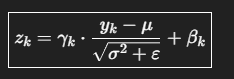

**Ho 2 parametri gamma e beta, anche questi vengono addestrati dalla rete**  
anche se è solo una formula, è per questo che abbiamo un oggetto/classe dedicato 

In [55]:
import torch
import torch.nn as nn


# Ereditiamo da nn.Module, che fornisce funzionalità di base per le reti neurali
class ResidualLayerNorm(nn.Module):
    def __init__(self, dim_model=128): # dimensione del wordVector
        super().__init__()

        # Genero l'oggetto che fa la Layer Normalization
        self.layer_norm = nn.LayerNorm(dim_model)

    # funzione forward applicata dal layer normalizzation
    # X è il tensore originale (4000x64x128) ogni WordVector rappresenta LE PAROLE INDIVIDUALMENTE
    # OUT e' il tensore calcolato dalla MHSA (4000x64x128) ogni WordVector rappresenta LE PAROLE NEL CONTESTO DELLA FRASE
    def forward(self, x, out):

        # Residual Connection
        # sommo i 2 vettori, in modo da mantenere le informazioni passate
        # migliora l'efficienza della rete, che impara anche dalle rappresentazioni passate
        y = x + out
        
        # Layer Normalization
        # normalizzo il tensore risultante dalla somma, che potrebbe avere valori troppo alti o bassi
        # per ogni wordVector , normalizzo le 128 feature  fi - media / deviazione standard
        z = self.layer_norm(y)
        
        return z


In [56]:

dim_model = 128   # perché i tuoi wordVector hanno dimensione 128

res_norm = ResidualLayerNorm(dim_model=dim_model)

# Mettiamo il modulo in modalità evaluation
res_norm.eval()

# Disabilitiamo il gradiente perché siamo in fase di sola trasformazione dei dati
with torch.no_grad():

    # ===== TRAIN SET =====
    z_trainMC  = res_norm(emb_tensor_MC,  mhsa_trainMC)
    z_trainITA = res_norm(emb_tensor_ITA, mhsa_trainITA)
    z_trainALL = res_norm(emb_tensor_ALL, mhsa_trainALL)

    # ===== TEST SET =====
    z_testMC   = res_norm(emb_tensor_test_MC,  mhsa_testMC)
    z_testITA  = res_norm(emb_tensor_test_ITA, mhsa_testITA)
    z_testALL  = res_norm(emb_tensor_test_ALL, mhsa_testALL)


In [57]:
# Questi saranno quindi i tensori finali dopo la Residual Layer Normalization

z_trainMC  = z_trainMC    # Output Residual LayerNorm training set MC
z_trainITA = z_trainITA   # Output Residual LayerNorm training set IronITA     
z_trainALL = z_trainALL   # Output Residual LayerNorm training set unito MC + IronITA
z_testMC   = z_testMC     # Output Residual LayerNorm test set MC
z_testITA  = z_testITA    # Output Residual LayerNorm test set IronITA
z_testALL  = z_testALL    # Output Residual LayerNorm test set unito MC + IronITA

# La struttura
# di ogni tensore è: [frasi_dataset (4000), 64 parole_per_frase (con padding), wordVector_parola 128 ]
# OGNI WordVector ORA RAPPRESENTA IL SIGNIFICATO INDIVDUALE DELLA PAROLA + SIGNIFICATO NEL CONTESTO DELLA FRASE, NORMALIZZATO

# Le Padding Mask rimangono le stesse
# mask_MC, mask_ITA, mask_ALL, mask_test_MC, mask_test_ITA, mask_test_ALL (num_frasi x 64)

# FEED-FORWARD NETWORK (FFN)

Quindi la MHSA ha guardato le relazioni tra le parole, ora ogni parola ha un significato contestualizzato alla frase in cui sta   
(Quindi guarda l'intera frase insieme)  
  
Adesso serve un layer che elabora il contenuto della singola parola una per una.  
(Voglio raffinare ogni parola indipendentemente dalle altre)  
  
**Viene applicata una mini rete neurala FFN a ogni parola**  
!! dato in input un vettore di n (128) elementi, ritorna in output un nuovo vettore di n (128) elementi 


Quindi io ho il mio tensore (4000x64x128)
per ogni frase, ho una parola che è xi = [x0...x127]  

per ogni parola x
prendo una matrice di pesi W = 128 x 128
prendo un vettore di bias b = 128
   
z = x * W + b  moltiplico  (1 x 128) x (128 x 128) + 128  => riottengo un vettore di z = (1 x 128)  +
(letteralmente sto applicando una trasformazione spaziale al vettore originale)  

h = f(z)  applico una funzione di attivazione RELU =  a feature x feature (se zi < 0 = 0, altrimenti = zi )
  
  
**Mini rete neurale fatta da un solo layer, che torna in output un vettore diverso ma con la stessa forma**
**DEVI VEDERLA COME , LA PAROLA E' L'INPUT x1...x128 -> ho 1 hidden layer di 128 neuroni, fully connected -> ogni neuorne torna la nuova feature, 128 feature posso ricostruire il vettore**  
  
Ogni parola appunto è elaborata indipendentemente

**Nel nostro trasformer applichiamo 2 neuroni FFN uno dopo l'altro**  
x -> x * W + b = z -> f(z) = h -> h * W' + b' = NO z' -> f(z')NO = h'   
(non si effettua la seconda funzione di attivazione, solo nel primo neurone)
  
QUINDI AVREMO 2 MATRICI W e W' , e 2 vettori b e b' DA ADDESTRARE  
  
QUINDI OTTENIAMO PER OGNI PAROLA X -> h' TRASFORMIAMO IL VETTORE..  
se lo applichiamo a tutte le parole di tutte le 4000 frasi,

OTTENIAMO UN NUOVO TENSORE 4000x64x128 , CONTENTENTE TUTTE LE PAROLE PER OGNI FRASE, MA IL WordVector sarà trasformato  
IL PASSAGGIO SERVE A DARE UNA NUOVA STRUTTURA AI WORDVECTORS, IN MODO DA PRENDERE MAGGIORI INFORMAZIONI SULLA PAROLA

In [58]:
import torch
import torch.nn as nn


# Ereditiamo da nn.Module, che fornisce funzionalità di base per le reti neurali
# Implementa il Feed-Forward Network (FFN), quindi riformuliamo ogni wordVector per ogni parola di ogni frase
# applichiamo una mini rete neurale due strati lineari con funzione di attivazione ReLU in mezzo

# (PositionWise perché lo applichiamo ad ogni parola indipendentemente, quindi "per posizione" nella frase)

class PositionWiseFFN(nn.Module):
    def __init__(self, dim_model=128):
        super().__init__()
        
        # nn.linear crea uno strato di una rete (fully connected), da input 128 a output 128

        # Primo strato della FFN: 128 -> 128
        self.linear1 = nn.Linear(dim_model, dim_model)

        # Secondo strato della FFN: 128 -> 128
        self.linear2 = nn.Linear(dim_model, dim_model)

        # crea l'oggetto Funzione di attivazione ReLU, da usare nei neuroni del PRIMO STRATO
        self.activation = nn.ReLU()
        
        
    # Funzione forward: verrà eseguita per applicare la transformazione FFN
    # passo X , il tensore in ingresso (4000x64x128), proveniente dalla precedente Residual Layer Norm
    # 4000 frasi, 64 parole per frase, 128 feature per parola
    # ogni vettore rappresenta la parola nel contesto + significato individuale normalizzato

    def forward(self, x):
       
        z = self.linear1(x)  # z è il tensore risultato dopo avver applicato il prodotto scalare + bias del primo strato    
        h = self.activation(z)   # applico quindi a ogni feature di ogni wordVector la funzione ReLU , ottengo h
        y = self.linear2(h)    # y è il tensore risultato dopo aver applicato il prodotto scalare + bias del secondo strato
        # non applico nessuna attivazione dopo il secondo strato, lascio i valori così come sono

        return y                 

# Bisogna addestrare le matrici 128x128 e i 2 bias 128 dei due strati della FFN  self.linear1 e self.linear2

# Applichiamo anche al padding, perché la FFN è indipendente dalla posizione della parola nella frase,
# E' una trasfomazione per ogni parola, trasformare i padding non influenzerà il resto della frase


In [59]:
dim_model = 128  # dimensione dei tuoi wordVector

ffn = PositionWiseFFN(dim_model=dim_model)
ffn.eval()   # modalità eval, visto che ora stiamo solo trasformando i tensori

with torch.no_grad():

    # ===== TRAIN SET =====
    ffn_trainMC  = ffn(z_trainMC)     # [N_MC, 64, 128]
    ffn_trainITA = ffn(z_trainITA)    # [N_ITA, 64, 128]
    ffn_trainALL = ffn(z_trainALL)    # [N_ALL, 64, 128]

    # ===== TEST SET =====
    ffn_testMC   = ffn(z_testMC)      # [N_MC_test, 64, 128]
    ffn_testITA  = ffn(z_testITA)     # [N_ITA_test, 64, 128]
    ffn_testALL  = ffn(z_testALL)     # [N_ALL_test, 64, 128]

    print("=== SHAPE DEI TENSORI FFN ===")
    print("ffn_trainMC.shape  :", ffn_trainMC.shape)
    print("ffn_trainITA.shape :", ffn_trainITA.shape)
    print("ffn_trainALL.shape :", ffn_trainALL.shape)
    print("ffn_testMC.shape   :", ffn_testMC.shape)
    print("ffn_testITA.shape  :", ffn_testITA.shape)
    print("ffn_testALL.shape  :", ffn_testALL.shape)

=== SHAPE DEI TENSORI FFN ===
ffn_trainMC.shape  : torch.Size([3995, 64, 128])
ffn_trainITA.shape : torch.Size([3976, 64, 128])
ffn_trainALL.shape : torch.Size([7971, 64, 128])
ffn_testMC.shape   : torch.Size([938, 64, 128])
ffn_testITA.shape  : torch.Size([872, 64, 128])
ffn_testALL.shape  : torch.Size([1810, 64, 128])


In [60]:
# Dataset finali dopo il PositionWise Feed-Forward Network

ffn_trainMC  = ffn_trainMC    # Output FFN training set MC
ffn_trainITA = ffn_trainITA   # Output FFN training set IronITA
ffn_trainALL = ffn_trainALL   # Output FFN training set unito MC + IronITA
ffn_testMC   = ffn_testMC     # Output FFN test set MC
ffn_testITA  = ffn_testITA    # Output FFN test set IronITA
ffn_testALL  = ffn_testALL    # Output FFN test set unito MC + IronITA

# La struttura
# di ogni tensore è: [frasi_dataset (4000), 64 parole_per_frase (con padding), wordVector_parola 128 ]
# OGNI WordVector ORA RAPPRESENTA IL SIGNIFICATO INDIVDUALE DELLA PAROLA + SIGNIFICATO NEL CONTESTO DELLA FRASE, NORMALIZZATO
# RIFORMULATO DAL FEED-FORWARD NETWORK, QUINDI IL SIGNIFICATO INDIDUALE DELLA PAROLA E' STATO TRASFORMATO

# Le Padding Mask rimangono le stesse
# mask_MC, mask_ITA, mask_ALL, mask_test_MC, mask_test_ITA, mask_test_ALL (num_frasi x 64)

# La seconda Residual Connection

### Somma 
chiamo x il vettore prima del FFN  
chiamo y il vettore dopo del FFN  
  
allora r = x + y , questo in modo da non buttare via le informazioni passate,  
la rete sfrutterà tutte le informazioni possibili per imparare a capire le parole

Ottengo sempre lo stesso tensore con la stessa dimensione

### LayerNormalizzation
Data una somma, per evitare che i valori diventino troppo grandi, si normalizza

Applichiamo una normalizzazione per ogni parola della frase  
   
Z = LayerNorm(Y)  
  
Z[i] = (Y[i] - media_i) / deviazione_std_i
  
Abbiamo appena fatto una somma, vogliamo evitare che i valori diventino troppo grandi, rende il training più stabile.




![image-2.png](attachment:image-2.png)

**Ho 2 parametri gamma'' e beta'', anche questi vengono addestrati dalla rete**  
anche se è solo una formula, è per questo che abbiamo un oggetto/classe dedicato 

In [61]:
# Posso sfruttare la classe ResidualLayerNorm gia prima definita per la prima layernorm dopo mhsa

# !! QUESTA ISTANZA AVRA' I SUOI BETA E GAMMA, DIVERSI DA QUELLI USATI PRIMA !!
# devo addestrare anche loro


res_norm_ffn = ResidualLayerNorm(dim_model=128)
res_norm_ffn.eval()   # ora solo trasformazione, niente training


with torch.no_grad():

    # ===== TRAIN SET =====
    encoder_out_trainMC  = res_norm_ffn(z_trainMC,  ffn_trainMC)
    encoder_out_trainITA = res_norm_ffn(z_trainITA, ffn_trainITA)
    encoder_out_trainALL = res_norm_ffn(z_trainALL, ffn_trainALL)

    # ===== TEST SET =====
    encoder_out_testMC   = res_norm_ffn(z_testMC,  ffn_testMC)
    encoder_out_testITA  = res_norm_ffn(z_testITA, ffn_testITA)
    encoder_out_testALL  = res_norm_ffn(z_testALL, ffn_testALL)

    print("=== SHAPE DEI TENSORI ENCODER OUT ===")
    print("encoder_out_trainMC.shape  :", encoder_out_trainMC.shape)
    print("encoder_out_trainITA.shape :", encoder_out_trainITA.shape)
    print("encoder_out_trainALL.shape :", encoder_out_trainALL.shape)
    print("encoder_out_testMC.shape   :", encoder_out_testMC.shape)
    print("encoder_out_testITA.shape  :", encoder_out_testITA.shape)
    print("encoder_out_testALL.shape  :", encoder_out_testALL.shape)

# sempre stessa dimensione dei tensori in input, faccio la somma elemento per elemento e normalizzo



=== SHAPE DEI TENSORI ENCODER OUT ===
encoder_out_trainMC.shape  : torch.Size([3995, 64, 128])
encoder_out_trainITA.shape : torch.Size([3976, 64, 128])
encoder_out_trainALL.shape : torch.Size([7971, 64, 128])
encoder_out_testMC.shape   : torch.Size([938, 64, 128])
encoder_out_testITA.shape  : torch.Size([872, 64, 128])
encoder_out_testALL.shape  : torch.Size([1810, 64, 128])


In [62]:
# Questi saranno quindi i tensori finali dopo il secondo Residual Layer Normalization

F_trainMC  = encoder_out_trainMC    # Output finale Encoder training set MC
F_trainITA = encoder_out_trainITA   # Output finale Encoder training set IronITA
F_trainALL = encoder_out_trainALL   # Output finale Encoder training set unito MC + IronITA
F_testMC   = encoder_out_testMC     # Output finale Encoder test set MC
F_testITA  = encoder_out_testITA    # Output finale Encoder test set IronITA
F_testALL  = encoder_out_testALL    # Output finale Encoder test set unito MC + IronITA

# La struttura
# di ogni tensore è: [frasi_dataset (4000), 64 parole_per_frase, wordVector_parola 128 ]
# OGNI WordVector quindi è una trasformazione
# rapprensenta l'insime del significato individuale della parola + significato nel contesto della frase
# normalizzato e riformulato

# Le Padding Mask rimangono le stesse
# mask_MC, mask_ITA, mask_ALL, mask_test_MC, mask_test_ITA, mask_test_ALL (num_frasi x 64)

**FINITO IL PROCESSO DI ENCODING**  
**Questa fase viene fatta da qualsiasi modello generale, senza guardare lo scopo specifico**  
(E viene fatto quando serve che il modello capisca il più possibile la semantica della frase, cioè il suo significato reale come farebbe una persona vera, e non si soffermi alla struttura grammaticale e alle singole parole individuali)  
  
Ora passiamo alla struttura per effettuare la nostra task = CLASSIFICAZIONE BINARIA (ironia o non ironia)

# POOLING
Ma il tuo task non è: “questa parola è ironica?” ma “questa frase è ironica?”  
  
Quindi vogliamo che la NOSTRA **MATRICE FRASE** -> DIVENTI UN **VETTORE FRASE**,  [parola0,parola1,parola2...]
in modo da essere usato come input   
  
Esistono diversi modi per farlo,  
Mean polling = ogni parola diventa la media delle sue feature
Max polling = ogni parola diventa il valore massimo per la frature
attention pooling = una mini attention da cui estrarre un valore solo per parola 

**DEVE ESSERE APPLICATO SOLO SULLE PAROLE NON PAD**

### Mean Polling
Standard in molti modelli con task simili al nostro (classificazione come sentiment analysis, irony detection)  
  
Ho il mio tensore F risultante dal encoding, (4000x64x128), ogni frase quindi è una matrice 64x128,  
vogliamo trasformare quella matrice in un vettore di 128 elementi  
**Cosi posso dare in input alla prossima rete una intera frase come vettore e non come matrice**  

Quindi per ogni frase delle 4000 costruisco un vettore di 128 elementi,  
**FACCIO LA MEDIA DI OGNI i-esima FEATURE DELLE 128, ottenendo così un vettore di 128 elementi riassuntivo della frase**  
  
Sto facendo quindi la media delle parole nella frase, (dimensione per dimensione / colonna per colonna), 
il vettore sarà un riassunto medio delle parole all'interno di uno spazio 128 dimensionale  
  
**Nella media di ogni colonna, ignorerò le righe delle parole padding**

La formula finale per ogni vi i-esima frase

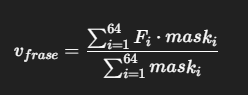  

dove Fi è l'i-esima feature della vi esima parola, 
se la parola i-esima è padding , maski = 0 , e tutte le sue feature saranno annullate,  
divido solo per le parole non padding  
  
(Nel codice viene applicato con **Moltiplicazione broadcasting**, elemento per elemento con la maschera)  
.. sotto spiega meglio

In [63]:

import torch
import torch.nn as nn

# Classe che svolgerà il layer di Mean Pooling
# trasforma le 4000 frasi, ognuna adesso una matrice 64x128 (64 parole, 128 feature per parola)
# in 4000 vettori di dimensione 128 (una rappresentazione densa per ogni frase)
# in modo da avere un vettore per frase, da dare in input alla rete di classificazione finale

# PADDING MASK
# => NON VOGLIAMO CHE LE PAROLE DI PADDING INFLUISCANO SULLA MEDIA FINALE, (cioè sulla rappresentazione riassuntiva della frase)
# le escludiamo dal calcolo della media
# la mask ha dimensione [4000, 64] , con 1 per parola vera e 0 per padding, quindi la sfruttiamo
# per eliminare le parole di padding mask = 0


class MeanPooling(nn.Module):
    def __init__(self):
        super().__init__()
        

    #funzione forward, eseguirà il mean pooling
    # prende in input quindi X il tensore (4000x64x128) e la mask (4000x64) , derivanti dalla fase di encoding
    def forward(self, x, mask):
       
        # La mask ha dimensione [B, L]  (4000x64) quindi pila di vettori
        # dobbiamo espanderla in una pila di matrici per poterla moltiplicare con X  (4000x64x128)
        # quindi ora (4000x64x1) ogni parola avrà una matrice di 64 righe e 1 colonna che indica se è parola vera o padding
        mask_expanded = mask.unsqueeze(-1)     
        mask_expanded = mask_expanded.to(x.dtype)    

        # MOLTIPLICAZIONE BROADCASTING
        # moltiplichiamo X per la mask espansa (4000x64x128) * (4000x64x1) non possono fare il prodotto scalare
        # ma grazie al broadcasting di PyTorch, la mask viene "estesa" automaticamente a (4000x64x128)
        # ogni vettore di mask prende la prima colonna che c'è gia e la copia su tutte le 128 feature
        # quindi otteniamo un tensore (4000x64x128) dove le se la parola è vera, la riga è tutta 1, 0 se padding
        # POI FACCIAMO LA MOLTIPLICAZIONE ELEMENTO PER ELEMENTO, non il prodotto scalare
        # OTTENGO X MASKED (4000x64x128) dove le righe/parole di padding sono tutte 0, le righe delle parole vere sono INVARIATE DA X
        x_masked = x * mask_expanded        
        # in torch per fare il prodotto scalare fai .matmul , qui usiamo * che fa la moltiplicazione elemento per elemento
        # se le matrici non sono uguali, PyTorch applica il broadcasting (cioè se la matrice è 64x1 la estende a 64x128 copiando la colonna su tutte le 128 colonne in automatico)         

        # Sommo su dim=1(colonne, feature per feature, quindi sommo le parole della frase)
        # +0 le feature delle parole di padding
        sum_x = x_masked.sum(dim=1)   
        # Ottengo un vettore per ogni frase (4000x128), ogni elemento è la somma delle 128 feature             

        # Sommo frase per frase, il numero di parole vere (mask=1), senza padding
        # ottengo un valore reale per ogni frase (4000x1) con il numero di parole vere della frase
        lengths = mask_expanded.sum(dim=1)          

        # Evito divisione per zero (se la frase è tutta padding)
        # se ho una FRASE VUOTA "", tutto padding, lenghts verrà 0 
        # in quel caso al posto di 0 metto lenghts = -inf un valore molto piccolo
        lengths = torch.clamp(lengths, min=1e-8)

        # CALCOLO LA MEDIA PER OGNI FEATURE, SOMMA FEATURES COLONNA / NUMERO PAROLE VERE
        # ottengo quindi un vettore per ogni frase (4000x128), il vettore è la MEDIA DI TUTTE LE PAROLE (non padding)
        sent_repr = sum_x / lengths                  

        # COSI' RAPPRESENTO OGNI FRASE NON PIU COME UNA MATRICE MA COME UN VETTORE

        return sent_repr    
    
        # la media permette di non perdere troppa informazione da ogni parola, riassumendo il significato complessivo della frase


In [65]:
# Istanzio il layer di Mean Pooling
mean_pool = MeanPooling()

# Metto in eval e disabilito gradienti perché qui stai solo preparando i tensori
mean_pool.eval()

with torch.no_grad():
    # TRAINING SET
    S_trainMC  = mean_pool(F_trainMC,  mask_MC)        # [N_trainMC, 128]
    S_trainITA = mean_pool(F_trainITA, mask_ITA)       # [N_trainITA,128]
    S_trainALL = mean_pool(F_trainALL, mask_ALL)       # [N_trainALL,128]

    # TEST SET
    S_testMC   = mean_pool(F_testMC,   mask_test_MC)   # [N_testMC, 128]
    S_testITA  = mean_pool(F_testITA,  mask_test_ITA)  # [N_testITA,128]
    S_testALL  = mean_pool(F_testALL,  mask_test_ALL)  # [N_testALL,128]

print("=== SHAPE DEI TENSORI FINALE S (RAPPRESENTAZIONE FRASE) ===")
print("S_trainMC.shape  :", S_trainMC.shape)    
print("S_trainITA.shape :", S_trainITA.shape)
print("S_trainALL.shape :", S_trainALL.shape)
print("S_testMC.shape   :", S_testMC.shape)
print("S_testITA.shape  :", S_testITA.shape)
print("S_testALL.shape  :", S_testALL.shape)

# Stampa del vettore della prima frase come dimostrazione
vec0 = S_trainMC[0].detach().cpu().numpy()
print("Prima frase (train_MC) - testo:")
print(train_MC.iloc[0]["text"])
print("\nVettore S_trainMC[0] shape:", vec0.shape)
print("Vettore S_trainMC[0]:")
print(vec0)


=== SHAPE DEI TENSORI FINALE S (RAPPRESENTAZIONE FRASE) ===
S_trainMC.shape  : torch.Size([3995, 128])
S_trainITA.shape : torch.Size([3976, 128])
S_trainALL.shape : torch.Size([7971, 128])
S_testMC.shape   : torch.Size([938, 128])
S_testITA.shape  : torch.Size([872, 128])
S_testALL.shape  : torch.Size([1810, 128])
Prima frase (train_MC) - testo:
ogni volta che parte un corteo radicale, il centro città diventa un percorso a ostacoli.

Vettore S_trainMC[0] shape: (128,)
Vettore S_trainMC[0]:
[ 5.64320982e-02 -2.92526960e-01 -9.08583626e-02  4.85063493e-01
  5.42972803e-01  2.80295819e-01  3.96544812e-03 -4.13846672e-02
  6.11823723e-02 -2.73293167e-01 -8.30206834e-03  3.90814036e-01
 -8.01621377e-02  5.02732277e-01 -2.65434776e-02 -3.01122665e-01
  5.93222715e-02 -8.88708420e-03 -7.48599589e-01  2.79670119e-01
 -1.29443184e-01  6.05968526e-03 -3.08441755e-04  1.95680514e-01
  8.15984607e-02  4.95237529e-01 -1.71998218e-01 -2.86607314e-02
 -3.93918157e-01 -2.12103605e-01  3.45113911e-02  

In [ ]:
# Vettori finali dopo il Mean Pooling
S_trainMC  = S_trainMC    # Rappresentazioni frasi training set MC
S_trainITA = S_trainITA   # Rappresentazioni frasi training set IronITA 
S_trainALL = S_trainALL   # Rappresentazioni frasi training set unito MC + IronITA
S_testMC   = S_testMC     # Rappresentazioni frasi test set MC
S_testITA  = S_testITA    # Rappresentazioni frasi test set Iron
S_testALL  = S_testALL    # Rappresentazioni frasi test set unito MC + IronITA
# La struttura
# di ogni tensore è: [frasi_dataset (4000), 1 vettore per frase (128 feature)]

# !! ALLA FINE QUINDI HO TRASFORMATO FRASI DI 64 PAROLE IN VETTORI DI 128 DIMENSIONI !!
# OTTENENDO UNA RAPPRESENTAZIONE PIU INFORMATIVA DI OGNI FRASE


# RETE CLASSIFICATORE
Ricordo che fino ad ora stiamo solo applicando la fase di FORWARDING, partendo da **PESI CASUALI**,  
L'addestramento avverrà alla fine, **Bisogna addestrare anche i pesi precedenti del intero modello**

Ora applicheremo una rete neurale classica,
**OBBIETTVO CLASSIFICAZIONE BINARIA, DATO IN PASTO IL VETTORE DA 128 RITORNA UNA PROBABILITA' [0,1] FRASE IRONICA**  
  
etichette 0 non ironia, 1 ironia  (dovrò recuperale, adesso i tensori S non c'è le hanno più)

### Architettura usata
è un problema classico di classificazione binaria, usiamo una struttura classica :

- **Output 1 nodo**, a cui è applicata la funzione di attivazione : **sigmoid**
- Quindi come LOSS = **Cross-entropy binaria**
- Solo un layer input (128) - un layer output (1 nodo)

**PER IL MOMENTO FACCIAMO SOLO 2 LAYER, NESSUNO HIDDEN**  
valutiamo quanto è veloce la RTX 2080 , e nel caso modifichiamo questa parte poi  
IN TEORIA DOVREBBE PORTARE A UNA BUONA EFFICIENZA COMUNQUE, VISTO CHE IL GROSSO DEL LAVORO E' GIA STATO FATTO NEL ENCODER  
POSSIAMO PROVARE A VEDERE SE MIGLIORANO ULTERIORMENTE

In [ ]:
import torch
import torch.nn as nn

# Classe che implementa la rete di classificazione finale
# Ereditiamo da nn.Module, che fornisce funzionalità di base per le reti neurali

class SentenceClassifier(nn.Module):
    def __init__(self, dim_model=128):  # vuole la dimensione del vettore frasi in input
        super().__init__()
        
        # nn.Linear crea un fully connected layer di una rete neurale
        # da input dim_model (128) a output 1 (logit per classe positiva)
        # ISTANZIA CON VALORI CASUALI, DA ADDRESTRARE POI
        self.linear = nn.Linear(dim_model, 1) 

        # prima aveva usato nn.Linear(dim_model, 128) per la FFN, quindi in output 128 neuroni...


    # Funzione forward, applico il forwarding con i valori attuali
    def forward(self, x):
        
        # applica il forwarding, ottenendo il valore reale del ultimo neurone (logit)
        # SOLO PRODOTTO SCALARE + BIAS, NESSUNA FUNZIONE DI ATTIVAZIONE (non ancora sigmoide)
        # z = x1*w1 + x2*w2 + ... + b  SOLO Z NEL PASSO DI FORWARDING
        logits = self.linear(x)   
        
        return logits
    
    # Significa che dovrò addestrare 128 pesi + 1 bias
    # nella fase di addestramento, verrà usata come LOSS la BCEWithLogitsLoss di torch (la Binary Cross Entropy con Sigmoide interna)

In [71]:

# Dimensione del vettore frase dopo il Mean Pooling
dim_model = 128

# Istanzio il classificatore
classifier = SentenceClassifier(dim_model=dim_model)

# Per ora lo mettiamo in modalità evaluation (solo forward, niente training)
classifier.eval()

with torch.no_grad():
    # TRAINING SET
    logits_trainMC  = classifier(S_trainMC)    # [N_trainMC, 1]
    logits_trainITA = classifier(S_trainITA)   # [N_trainITA, 1]
    logits_trainALL = classifier(S_trainALL)   # [N_trainALL, 1]

    # TEST SET
    logits_testMC   = classifier(S_testMC)     # [N_testMC, 1]
    logits_testITA  = classifier(S_testITA)    # [N_testITA, 1]
    logits_testALL  = classifier(S_testALL)    # [N_testALL, 1]

with torch.no_grad():
    # TRAINING SET
    logits_trainMC  = classifier(S_trainMC)    # [N_trainMC, 1]
    logits_trainITA = classifier(S_trainITA)   # [N_trainITA, 1]
    logits_trainALL = classifier(S_trainALL)   # [N_trainALL, 1]

    # TEST SET
    logits_testMC   = classifier(S_testMC)     # [N_testMC, 1]
    logits_testITA  = classifier(S_testITA)    # [N_testITA, 1]
    logits_testALL  = classifier(S_testALL)    # [N_testALL, 1]

print("=== SHAPE DEI LOGITS FINALI ===")
print("logits_trainMC.shape  :", logits_trainMC.shape)
print("logits_trainITA.shape :", logits_trainITA.shape)
print("logits_trainALL.shape :", logits_trainALL.shape)
print("logits_testMC.shape   :", logits_testMC.shape)
print("logits_testITA.shape  :", logits_testITA.shape)
print("logits_testALL.shape  :", logits_testALL.shape)


=== SHAPE DEI LOGITS FINALI ===
logits_trainMC.shape  : torch.Size([3995, 1])
logits_trainITA.shape : torch.Size([3976, 1])
logits_trainALL.shape : torch.Size([7971, 1])
logits_testMC.shape   : torch.Size([938, 1])
logits_testITA.shape  : torch.Size([872, 1])
logits_testALL.shape  : torch.Size([1810, 1])


## Recuperare le label
Nei tensori non ci sono le label 0 o 1 (ironico/ non ironico), bisogna recuperarli per il calcolo della Loss,  
L'ultima volta che li abbiamo usati erano nel dataset, avevamo una colonna "label", 4000x1 ogni riga è una frase,  
il vettore di 0 o 1 intero , se la frase è ironica o non ironica.

In [73]:
# Estraggo le label dai dataframe, li trasformo in tensori torch,
# L'ORDINE DELLE RIGHE OVVIAMENTE SARA' LO STESSO VISTO CHE NON E' MAI STATO MODIFICATO

# TRAIN
y_trainMC  = torch.tensor(train_MC["label"].values,  dtype=torch.float32).unsqueeze(1)   # [N_trainMC, 1]
y_trainITA = torch.tensor(train_ITA["label"].values, dtype=torch.float32).unsqueeze(1)  # [N_trainITA,1]
y_trainALL = torch.tensor(train_all["label"].values, dtype=torch.float32).unsqueeze(1)  # [N_trainALL,1]

# TEST
y_testMC   = torch.tensor(test_MC["label"].values,   dtype=torch.float32).unsqueeze(1)  # [N_testMC,1]
y_testITA  = torch.tensor(test_ITA["label"].values,  dtype=torch.float32).unsqueeze(1)  # [N_testITA,1]
y_testALL  = torch.tensor(test_all["label"].values,  dtype=torch.float32).unsqueeze(1)  # [N_testALL,1]


# DEFINISCO UNA CLASSE CONTENITORE
CONTIENE PER OGNI FRASE DEL DATASET, IL SUO VETTORE F (128 feature), il text e la label
 


In [82]:
from torch.utils.data import Dataset

class SentenceFeatureDataset(Dataset):
    def __init__(self, features, labels, texts=None):
        """
        features : tensore [N, 128]   -> S_train*, S_test*
        labels   : tensore [N, 1]     -> y_train*, y_test*
        masks    : tensore [N, 64]    -> mask_*   (opzionale)
        texts    : lista di stringhe  -> df["text"] (opzionale)
        """
        self.features = features
        self.labels = labels
        self.texts = texts


    def __len__(self):
        return self.features.size(0)


    def __getitem__(self, idx):
        x = self.features[idx]    # [128]
        y = self.labels[idx]      # [1]
        t = self.texts[idx]       # stringa text

        return x, y, t

        



In [ ]:
# Istanzio la classe dataset per ogni dataset

train_dataset_MC = SentenceFeatureDataset(
    features = S_trainMC,
    labels   = y_trainMC,
    texts    = list(train_MC["text"].values)
)

train_dataset_ITA = SentenceFeatureDataset(
    features = S_trainITA,
    labels   = y_trainITA,
    texts    = list(train_ITA["text"].values)
)

train_dataset_ALL = SentenceFeatureDataset(
    features = S_trainALL,
    labels   = y_trainALL,
    texts    = list(train_all["text"].values)
)
test_dataset_MC = SentenceFeatureDataset(
    features = S_testMC,
    labels   = y_testMC,
    texts    = list(test_MC["text"].values)
)

test_dataset_ITA = SentenceFeatureDataset(
    features = S_testITA,
    labels   = y_testITA,
    texts    = list(test_ITA["text"].values)
)

test_dataset_ALL = SentenceFeatureDataset(
    features = S_testALL,
    labels   = y_testALL,
    texts    = list(test_all["text"].values)
)


In [84]:

print("=== DIMENSIONI DEI DATASET FINALE ===")
print("train_dataset_MC size  :", len(train_dataset_MC))
print("train_dataset_ITA size :", len(train_dataset_ITA))
print("train_dataset_ALL size :", len(train_dataset_ALL))
print("test_dataset_MC size   :", len(test_dataset_MC))
print("test_dataset_ITA size  :", len(test_dataset_ITA))
print("test_dataset_ALL size  :", len(test_dataset_ALL))




=== DIMENSIONI DEI DATASET FINALE ===
train_dataset_MC size  : 3995
train_dataset_ITA size : 3976
train_dataset_ALL size : 7971
test_dataset_MC size   : 938
test_dataset_ITA size  : 872
test_dataset_ALL size  : 1810


In [87]:
# stampa 3 frasi di esempio dal training set MC
for i in range(5):
    text = train_MC.iloc[i]["text"]
    label = int(train_MC.iloc[i]["label"])
    feat = S_trainMC[i].detach().cpu()           # tensore [128]
    first_vals = feat[:8].numpy()                # primi 8 valori della feature
    shape = tuple(feat.shape)

    print(f"--- Esempio {i} ---")
    print("Text :", text)
    print("Label:", label)
    print("Feature shape:", shape)
    print("Prime values:", first_vals.tolist())
    print()


--- Esempio 0 ---
Text : ogni volta che parte un corteo radicale, il centro città diventa un percorso a ostacoli.
Label: 1
Feature shape: (128,)
Prime values: [0.056432098150253296, -0.2925269603729248, -0.09085836261510849, 0.48506349325180054, 0.5429728031158447, 0.28029581904411316, 0.003965448122471571, -0.04138466715812683]

--- Esempio 1 ---
Text : l'acqua è sempre piatta, non curva mai: è la prova più semplice che abbiamo.
Label: 0
Feature shape: (128,)
Prime values: [-0.038203585892915726, -0.3615756332874298, -0.10773911327123642, -0.010997050441801548, 0.3550798296928406, 0.22655868530273438, -0.011665231548249722, 0.048735279589891434]

--- Esempio 2 ---
Text : perfetto, ora ci manca solo che ti iscrivi alla nasa perché 'ti senti pronto'.
Label: 1
Feature shape: (128,)
Prime values: [-0.0791906863451004, -0.3177465796470642, 0.0023694224655628204, 0.1282869577407837, 0.45737847685813904, 0.43149474263191223, 0.31259942054748535, 0.045314155519008636]

--- Esempio 3 ---
Text 

Quindi : 

In [ ]:
# Logits finale, dopo tutta la fase di forwarding del modello ( cioè con pesi non addestrati ancora)

logits_trainMC  = logits_trainMC    # Logits training set MC
logits_trainITA = logits_trainITA   # Logits training set IronITA
logits_trainALL = logits_trainALL   # Logits training set unito MC + IronITA
logits_testMC   = logits_testMC     # Logits test set MC
logits_testITA  = logits_testITA    # Logits test set IronITA
logits_testALL  = logits_testALL    # Logits test set unito MC + IronITA

# La struttura
# di ogni tensore è: [frasi_dataset (4000), 1 logit per frase]

# OGNI LOGIT DOVREBBE ESSERE IL VALORE CHE DEFINISCE SE LA FRASE E' IRONICA O MENO (prima della sigmoide)
# dopo aver addestrato i pesi, questi valori (post sigmoide [0,1] ) dovranno essere il più vicino possibile alla laber reale
# (QUIUDI DOVRO' APPLICARE LA SIGMOIDE)

# --------------------------------------------------------------------------

# inforzioni sulle frasi del modello

Info_trainMc = train_dataset_MC   # dataset training Mc
Info_trainITA = train_dataset_ITA  # dataset training IronITA
Info_trainALL = train_dataset_ALL  # dataset training unito MC + IronITA
Info_testMC = test_dataset_MC     # dataset test Mc
Info_testITA = test_dataset_ITA    # dataset test IronITA
Info_testALL = test_dataset_ALL    # dataset test unito MC + IronITA

# La struttura
# ognuno è un istanza della classe SentenceFeatureDataset, che permettei di accedere a:
# - features: tensore [4000, 128]
# - labels: tensore [4000, 1]
# - texts: lista di stringhe con le frasi originali
# 
#  len(Info_trainMc) = 4000 torna il numero di frasi nel dataset
#  getitem(idx) torna la tupla (feature, label, text) per la frase al indice idx 

# FASE DI ADDESTRAMENTO
Abbiamo finito la fase di FORWARDING, ottenendo questi risultati finali MA CON PESI SCELTI A CASO  

**DOBBIAMO ADDESTRARE TUTTI I PESI DI OGNI FASE CHE ABBIAMO LASCIATO INDIETRO**

### Binary cross entorpy
Dato che è una classificazione binaria, definiamo la loss come una Binary cross entropy  

CIOE' IL CLASSIFICATORE FA : 

- prende il z = logits  QUINDI IL RISULTATO FINALE DELLA RETE
- applica un sigmoide  y' = sig(z)   OTTENENDO UN VALORE DI PREDIZIONE 
- più questo è simile alla label y , più è corretto il risultato e minore l'errore (loss)

quindi l'errore tra label e predizione Loss(y,y') = −[y⋅log(p)+(1−y)⋅log(1−p)]   
  
Se y = 1, il termine importante è -log(p) → se p è vicino a 1, la loss è piccola.  

Se y = 0, il termine importante è -log(1-p) → se p è vicino a 0, la loss è piccola.  

**In pytorch abbiamo la classe BCEWithLogitsLoss che calcola la loss perte**  
  
Poi bisogna calcolare la funzione di costo J(W) = 1/N-1 sum Loss(y,y') per tutto il dataset di frasi,  
(Quella sarà la vera funzione da minizzare, che dipenderà da tutti i parametri W usati nel modello )  

**In pytorch abbiamo BCEWithLogitsLoss(reduction='mean') che calcola la media delle loss per il dataset**  
(DEVE ESSERE MINIMIZZATA, CIOE' IL MENO POSSIBILE)  





### Training end-to-end
CIOE' COME ADDESTRARE TUTTI I PESI DI EMBEDDING + ENCODER + CLASSIFICATORE  
 
Abbiamo sfruttato le classi ereditate da pytorch in modo da gestire meglio l'addestramento di questi pesi...  
PERO' SONO SEPARATE IN PIU CLASSI, FACCIAMO UN CONTENITORE CHE RIPRENDE LE CLASSI  


def forward(input_ids):  
    # 1) embedding_layer → embeddings, mask  
    # 2) mhsa → out_attn  
    # 3) residual+layernorm (1)  
    # 4) ffn  
    # 5) residual+layernorm (2)  
    # 6) mean pooling → vettore 128  
    # 7) classifier → logit  
    return logits  





In [88]:

import torch
import torch.nn as nn

# classe finale, implementa l'intero modello end-to-end

class IronyEndToEndModel(nn.Module):
    # definiamo la struttura di base del modello
    def __init__(self, 
                 dim_vocabolario,      # dimensione del vocabolario (usiamo uno unico per tutti i dataset ITA + MC)
                 dim_wordVector=128,   # dimensione del wordVector (128 feature)
                 dim_frase=64,         # lunghezza massima della frase (64 parole)
                 num_heads=4):         # numero di teste della MHSA    
        super().__init__()


        # Istanzio i layer senza fare il forward

        # EMBEDDING LAYER 
        self.embedding_layer = EmbeddingLayer(      # istanzio l'embedding layer
            dim_vocabolario=dim_vocabolario,
            dim_wordVector=dim_wordVector,
            dim_frase=dim_frase,
            padding_idx=0
        )

        # MHSA LAYER
        self.mhsa = MultiHeadSelfAttention(      # istanzio la MHSA
            dim_model=dim_wordVector,
            num_heads=num_heads
        )

        # PRIMO RESIDUALNORM LAYER
        self.residual1 = ResidualLayerNorm(      # istanzio la prima Residual Layer Norm
            dim_model=dim_wordVector
        )
        

        # FFN LAYER
        self.ffn = PositionWiseFFN(              # istanzio il Feed-Forward Network
            dim_model=dim_wordVector
        )

        # SECONDO RESIDUALNORM LAYER
        self.residual2 = ResidualLayerNorm(      # istanzio la seconda Residual Layer Norm
            dim_model=dim_wordVector
        )

        # MEAN POOLING LAYER
        self.mean_pool = MeanPooling()            # istanzio il Mean Pooling Layer


        # CLASSIFICATORE FINALE
        self.classifier = SentenceClassifier(       # istanzio il classificatore finale
            dim_model=dim_wordVector
        )

    # EFFETTUAMO IL FORWARDING COMPLETO, I PESI SONO ISTANZIATI CASUALMENTE (non addestrati)

    # richiamando tutte le funzioni self.<layer>() che sono figlie della classe nn.Module
    # dentro la funzione forward, PYTORCH CHIAMERA' IN AUTOMATICO LE FUNZIONI FORWARD DI OGNI LAYER

    # Ricostuisco la pipeline fatta in precedenza, ogni tensore output sarà l'input del layer successivo
    def forward(self, input_ids):

        # ---- EMBEDDING (chiamo la funzione forward dell'embedding layer) ----
        
        token_emb, pos_emb, embeddings, mask = self.embedding_layer(input_ids) 
        
        # embeddings = tensore (4000x64x128) per ogni parola di ogni frase ho una rappresentazione di 128 feature = WORDVECTOR
        # il wordVector contiene l'informazione della parola + l'informazione della posizione nella frase (prima parola, seconda parola, ...)
        # padding mask = tensore (4000x64) per ogni frase un vettore di 64 elementi come le parole (1 parola vera, 0 padding)

        # (gli altri sono debugging output, non servono)

        # qui avremo 2 matrici : 
        # X cioè le rappresentazioni inziali delle parole (wordVector) e pos le rappresentazioni delle posizioni spaziali della matrice (posVector)  
        # entrambe saranno generate casualmente inizialmentente prima del forward, non possiamo conoscerle, la rete deve impararle da sole (addestrate)
        # chiamiamo X = W_e  e pos = W_p , e saranno pesi da addestrare
    

        # ---- MHSA (chiamo la funzione forward della MHSA) ----
    
        attn_out, M, A = self.mhsa(embeddings, mask=mask)

        # attn_out = tensore (4000x64x128) per ogni parola di ogni frase ottengo una nuova rappresentazione del wordVector sempre di 128 feature
        # trasforma il wordVector originale "embeddings", applicando matrici di pesi
        # ora è stato aggiunto al vettore il significato della parola nel contesto della frase, guardando i legami con le altre parole
        
        # (gli altri sono debugging output, non servono)

        # qui sarà da addestrare le matrici di pesi della MHSA (W_q, W_k, W_v, W_o)


        # ---- Residual + LayerNorm (1)  (chiamo la funzione forward della Residual LayerNorm) ----
        
        z1 = self.residual1(embeddings, attn_out)   

        # z1 = tensore (4000x64x128) per ogni parola di ogni frase ottengo un nuova rappresentazione del wordVector sempre di 128 feature
        # che è la somma del wordVector originale embeddings + il wordVector riformulato dalla MHSA attn_out e normalizza
        # questo in modo da non perdere informazioni sulle trasformazioni precedenti, migliora l'efficienza della rete

        # qui sarà da addestrare i parametri beta e gamma, scelti per capire come normalizzare al meglio i wordVector


        # ---- FFN (chiamo la funzione forward della FFN) ----

        ffn_out = self.ffn(z1)    

        # ffn_out = tensore (4000x64x128) per ogni parola di ogni frase ottengo un nuova rappresentazione del wordVector sempre di 128 feature
        # trasforma il wordVector riformulato dalla Residual LayerNorm z1, applicando 2 strati di rete neurale FFN
        # ora è stato aggiunto al vettore informazione sul significato individuale della parola, indipendente dalle altre parole

        # FFN = rete fully connected 2 strati che ha in input 128 feature e in output 128 feature (la Relu applicata solo nel layer 1)
        # qui sarà da addestrare le matrici di pesi dei 2 stati e i bias
        # dato che è fully connected - primo stato 128x128 + 128 bias , secondo stato 128x128 + 128 bias 
        

        # ---- Residual + LayerNorm (2) (chiamo la funzione forward della Residual LayerNorm) ----

        z2 = self.residual2(z1, ffn_out)      

        # z2 = tensore (4000x64x128) per ogni parola di ogni frase ottengo un nuova rappresentazione del wordVector sempre di 128 feature
        # che è la somma del wordVector precedente al FFN z1 + il wordVector riformulato dalla FFN ffn_out e normalizza   
        # questo in modo da non perdere informazioni sulle trasformazioni precedenti, migliora l'efficienza della rete   


        # ---- Mean Pooling (chiamo la funzione forward del Mean Pooling) ----

        sent_repr = self.mean_pool(z2, mask)        
        
        # sent_repr = tensore (4000x128) trasformo ogni matrice frase di z2 (4000x64x128)
        # in un vettore di 128 feature riassuntivo della frase, andando a fare la media delle feature di tutte le parole
        # viene usata la padding mask, per escludere nella media le parole di padding, non influenzano la frase finale

        # qui non ci sono pesi da addestrare, è solo una trasformazione matematica


        # ---- Classificatore (chiamo la funzione forward del classificatore) ----

        logits = self.classifier(sent_repr)         

        # logits = tensore (4000x1) dato in pasto tutte le frasi del dataset (4000) -> ottengo un singolo valore reale (logit)
        # applicando la sigmoide al logit è possibile ottenere la probabilità che la frase sia ironica (valore tra 0 e 1)

        # è una rete neurale di classificazione semplice, per il momento non aggiungiamo hidden layer
        # quindi solo 128 input vettor che rappresenta la frase e un neurone in output che ritorna il logit


        # trasformo i logit in un vettore unico y' (4000 logits) - vettore delle predizioni
        logits = logits.squeeze(-1)                 

        return logits
    
    # Otteniamo lo stesso riusultato = i logits finali per ogni frase (valore che messo nella sigmoide ci dice se è ironica o no)
    # abbiamo sempre lo stesso problema, nel forwarding i pesi sono casuali, non addestrati
    # quindi i logits non hanno senso, dobbiamo addestrare il modello prima di usarlo realmente


### Applichiamo la loss
Prima di addestrare, voglio scegliere un dataset, iniziare a passare le frasi una a una   
ottenere le logits , applico la sigmoide, calcolo la loss    

(vedere la macchina che respira)

In [89]:
# Ripartiamo quindi dai dataset base

train_MC = train_dfMC_pad    # training set MC 
test_MC  = test_dfMC_pad     # test set MC 
train_ITA = train_dfITA_pad  # training set IronITA 
test_ITA  = test_dfITA_pad   # test set IronITA 
train_all = train_all        # training set unito MC + IronITA
test_all  = test_all         # test set unito MC + IronITA

# di cui la struttura di ogni DataFrame è:
#   - text            : testo originale pulito
#   - label           : etichetta 0/1
#   - tokens          : lista di token (stringhe)
#   - tokens_int      : lista di token convertiti in ID (interi)
#   - input_ids       : lista di ID token padded/troncata a MAX_LEN
#   - attention_mask : lista di 1/0 per indicare token reali/padding


# vocabolario totale (MC + IronITA) *usiamo questo
vocabolario = vocab # struttura: dict token -> {"token": String, "id": int, "freq": int}       di cui 0 è <PAD> e 1 è <UNK>

# gli id sono messi in ordine crescente a partire da 0 di frequenza decrescente

In [91]:
# Quindi scelgo il dataset MC per attivare la macchina

IdVectors = train_MC["input_ids"]  # lista di 64 ID_token padded, gli id provenienti dal vocabolario totale (MC + IronITA)
labels = train_MC["label"]         # etichetta 0/1 per ogni frase del training set MC
texts = train_MC["text"]           # testo originale pulito per ogni frase del training set MC

1. Costruiamo una classe contenitore che aiuta a gestire il Dataset

In [ ]:
# Questa classe gestisce i tensori, viene passato il dataframe e lo trasforma in tensori torch
# manterremo l'ordine delle frasi del dataset, non verranno fatti shuffle dopo questo punto

# Eredita da torch.utils.data.Dataset funzioni comode per trattare il dataset/tensori
class TokenDataset(torch.utils.data.Dataset):

    # passo un dataset
    def __init__(self, df):
        self.input_ids = df["input_ids"].values  # lista di 64 ID_token padded, (basati dal vocabolario totale)
        self.labels = df["label"].values         # etichetta 0/1 per ogni frase (ironico non ironico)
        self.texts = df["text"].values           # testo originale pulito per ogni frase


    # ritorna la lunghezza del dataset (4000)
    def __len__(self):
        return len(self.labels)

    # dato un id frase, torna i TORCH TENSOR corrispondenti
    def __getitem__(self, idx):
        ids = torch.tensor(self.input_ids[idx], dtype=torch.long)   # lista dei 64 ID della frase idx
        label = torch.tensor(self.labels[idx], dtype=torch.float32)  # label 0/1 della frase idx
        text = self.texts[idx]                                       # testo originale della frase idx
        return ids, label, text

    # +  ------------------------------------------------------------------------------------
    # volendo potevano mettere anche la mask qui, 
    # (solo dimostrativa, abbiamo gia la funzione che la calcola in embedding layer)
    def get_mask(self, idx=None):
        
        # se non do idx, mi torna l'intero tensore per ogni frase (N x 64)
        if idx is None:
            masks_list = []                                     # inizializzo la matrice delle mask
            for seq in self.input_ids:                          # per ogni riga della matrice input_ids (cioè i vettori id delle frasi)
                seq_np = np.array(seq, dtype=np.int64)          # converto in numpy array il vettore id della frase
                mask_np = (seq_np != 0).astype(np.int64)        # creo la mask (un vettore di -> 1 dove non è <PAD>, 0 dove è <PAD>)
                masks_list.append(mask_np)                      # aggiungo la mask come riga della matrice

            masks_np = np.stack(masks_list, axis=0)             # converto la matrice in una matrice numpy (N x 64)
            return torch.tensor(masks_np, dtype=torch.long)     # converto la matrice in un torch tensor

        # altrimenti mi torna solo la mask per la frase idx [vettore di 64]
        else:
            seq_np = np.array(self.input_ids[idx], dtype=np.int64)   # converto il vettore id della frase idx in numpy array
            mask_np = (seq_np != 0).astype(np.int64)                 # creo la mask (un vettore di -> 1 dove non è <PAD>, 0 dove è <PAD>)
            return torch.tensor(mask_np, dtype=torch.long)           # converto il vettore mask in un torch tensor (vettore di 64)


In [125]:
Tensor_TrainMC = TokenDataset(train_MC)   # istanzio la classe con train_MC

# Esempio di estrazione del primo elemento, basta usare Tensor_TrainMC[0]

ids0, label0, text0 = Tensor_TrainMC[0]  

print(text0) 
print(ids0)      
print(label0)
print(Tensor_TrainMC.get_mask(0))  
   

ogni volta che parte un corteo radicale, il centro città diventa un percorso a ostacoli.
tensor([  60,   83,    5,  146,   11, 1115, 2447,    3,    7,  439,  351,  497,
          11,  904,   12, 7301,    2,    0,    0,    0,    0,    0,    0,    0,
           0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
           0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
           0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
           0,    0,    0,    0])
tensor(1.)
tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])


2. Istanziamo il modello

In [126]:
dim_vocabolario = len(vocabolario)   # numero di token diversi

model = IronyEndToEndModel(
    dim_vocabolario=dim_vocabolario,
    dim_wordVector=128,
    dim_frase=64,
    num_heads=4
)


3. Facciamo una dimostrazione con una frase, di come si calcola la **LOSS**

In [ ]:
# Prendiamo una frase di esempio dal dataset di training MC
# ED ESEGUIAMO IL FORWARDING COMPLETO

ids0, label0, text0 = Tensor_TrainMC[0]


# ids0 è un tensore vettore di 64 ID_token
# noi abbiamo costruito il modello per prendere in input UN INTERO BATCH DI FRASI (da 64 parole l'una) 4000x64 
ids0_batch = ids0.unsqueeze(0)  # trasformo la frase in un batch con 1 frase dentro (1x64)



# LA DO IN PASTO AL MODELLO COMPLETO
# model(batch) IN AUTOMATICO CHIAMA model.forward(per ogni elmento del batch) - non serve chiamare a mano la funzione forward
# se ho più di un elemento nel batch, PyTorch itera automaticamente tutti gli elementi, torna un tensore di logits

logit0 = model(ids0_batch)

print(logit0)

# ORA CALCOLIAMO LA LOSS DI QUESTA FRASE

# definisco l'oggetto che fa la Binary Cross Entropy (applica la sigmoide al logit, e calcola la loss BCE)
criterion = nn.BCEWithLogitsLoss()

# prendo la label della frase, lo inserisco in vettore (come se fosse il vettore delle label y di un batch)
label0_batch = label0.unsqueeze(0)   

# APPLICO LA loss(y,y') tra label reale e logit predetto
loss0 = criterion(logit0, label0_batch)
print("LOSS:", loss0.item())
# Come sappiamo, 0 non ha fatto errore - più è alto maggiore è l'errore

# possiamo anche leggere il valore dopo la sigmoide
prob0 = torch.sigmoid(logit0)
print("Probabilità frase ironica:", prob0.item())
print("label reale:", label0.item())


# VABBE NON HO FATTO ADDESTRAMENTO QUINDI I PESI SONO ANCORA CASUALI

tensor([-0.1394], grad_fn=<SqueezeBackward1>)
LOSS: 0.7652910947799683
Probabilità frase ironica: 0.46519848704338074
label reale: 1.0


4. BackPropagation

Ora sappiamo che i pesi W scelti , portano a un errore di 0.7 ,  
**DOBBIAMO PROVARE A SPOSTARE I PESI IN MODO DA RIDURRE QUESTO ERRORE**